<a href="https://colab.research.google.com/github/yamorita/AirBnB_BostonCrime/blob/main/Team4_The_impact_of_criminal_activity_on_AirBnB_listings.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# The impact of criminal activity on AirBnB listing

# Problem Objective
AirBnB has revolutionized the hospitality industry by enabling travelers to find affordable and unique accommodation options in popular tourist destinations. However, the safety of the neighborhoods where AirBnB listings are located can have a significant relationship with consumer behavior, including pricing and ratings. By analyzing the relatioonship of criminal activity on the AirBnB listings in Boston, we will attempt to understand consumer behavior and how consumers react to sociological impacts.

The business problem is to understand if there is a correlation between the number of crimes committed in a particular area and what relationship that has with the number of bookings on AirBnB in that area. This can help AirBnB hosts in Boston to make informed decisions about the pricing and management of their listings based on the safety of the area. If safer areas of the city receive higher ratings and prices than unsafe areas, it could suggest that safety is an important consideration for AirBnB guests when choosing a location to stay. This information can be useful for AirBnB hosts, as well as for policymakers and city planners who are interested in promoting safe and 
attractive neighborhoods. 

# Report Summary
Throughout this notebook we looked at, cleaned, interpreted, and compared data from our AirBnb dataset and our Boston crime dataset, in order to understand the implications of crime on number of AirBnb bookings and therefore pricing based on location. We faced a lot of challenges throughout the process when it came to joining our data, understanding what data to use, and therefore interpreting data. In the end, we were able to review our data, and come to our consensus that there was correlation between crime and consumer behavior when it came to booking an AirBnb, and even a slight correlation between crime and AirBnb listing price.

# Data source
To analyze this problem, we will be using two datasets. The first dataset is the AirBnB data in Boston, which contains information about the AirBnB listings in Boston, such as location, price, availability, and other relevant details. The second dataset is the Criminal Activity in Boston, which contains information about criminal incidents reported in Boston from 2015 to 2022 and includes information on the type of crime, location, date, and time of occurrence, among other details. 

- AirBnB data in Boston: https://data.world/fernandopereira/listing-boston
- Criminal Activity in Boston: https://www.kaggle.com/datasets/shivamnegi1993/boston-crime-dataset-2022

# Motivation
Our group is interested in consumer behavior and how consumers react to sociological relationships. We also wanted to gain a better understanding on how predictable AirBnb bookings can be, when crime is taken into account, and if we could further predict AirBnb price depending on crime in the location of the listing. 

# Import dataset

Our first step is to import the data we used, which can be seen **below**.

In [ ]:
from google.colab import drive
import pandas as pd

path = 'Stephanie' # To run on your environment, change to your name and set your paths in your "elif" block

!pip install geopandas -q
import geopandas as gpd
import json

if path == 'Yasu':
  drive.mount('/content/gdrive')
  listing = pd.read_excel("/content/gdrive/MyDrive/Class/IS833/Team4/listings.xlsx")
  crime = pd.read_csv("/content/gdrive/MyDrive/Class/IS833/Team4/Boston crime/csv_2017_2022.csv")
  offense_code = pd.read_excel("/content/gdrive/MyDrive/Class/IS833/Team4/Boston crime/rmsoffensecodes.xlsx")
  #if zcta is None:
  zcta = gpd.read_file("/content/gdrive/MyDrive/Class/IS833/Team4/tl_2022_us_zcta520.zip")
  ma_pop = pd.read_csv('/content/gdrive/MyDrive/Class/IS833/Team4/ma_population_2021.csv')
  with open('/content/gdrive/MyDrive/Class/IS833/Team4/ZIP_Codes.geojson') as f:
    geojson = json.load(f)
elif path == 'Lucky':
  drive.mount('/content/gdrive')
  listing = pd.read_excel("/content/gdrive/MyDrive/MSDT/Project/listings.xlsx")
  crime = pd.read_csv("/content/gdrive/MyDrive/MSDT/Project/Boston crime/csv_2017_2022.csv")
  offense_code = pd.read_excel("/content/gdrive/MyDrive/MSDT/Project/Boston crime/rmsoffensecodes.xlsx")
  with open('/content/gdrive/MyDrive/MSDT/Project/ZIP_Codes.geojson') as f:
    geojson = json.load(f)
elif path == 'Stephanie':
  try:
    import geopandas as gpd
  except:
    !pip install geopandas
    import geopandas as gpd
  drive.mount('/content/drive')
  listing = pd.read_excel("/content/drive/MyDrive/Team4/listings.xlsx")
  crime = pd.read_csv("/content/drive/MyDrive/Team4/Boston crime/csv_2017_2022.csv")
  offense_code = pd.read_excel("/content/drive/MyDrive/Team4/Boston crime/rmsoffensecodes.xlsx")
  zcta = gpd.read_file("zip:///content/drive/MyDrive/Team4/tl_2022_us_zcta520.zip")
  ma_pop = pd.read_csv('/content/drive/MyDrive/Team4/ma_population_2021.csv')
  with open('/content/drive/MyDrive/Team4/ZIP_Codes.geojson') as f:
    geojson = json.load(f)
elif path == 'Sheik':
  drive.mount('')
  listing = pd.read_excel("")
  crime = pd.read_csv("")
  offense_code = pd.read_excel("")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-195-79fe2b2d40fe>:35: DtypeWarning: Columns (1,3,7,13) have mixed types. Specify dtype option on import or set low_memory=False.
  crime = pd.read_csv("/content/drive/MyDrive/Team4/Boston crime/csv_2017_2022.csv")


# **Explore dataset**

Our next step is to study the data, so that we can better understand it, and utilize it effeciently.

### Description of dataset

Below is a detailed explanation of the column head names from the listing dataset for AirBnB. This dataset has 106 columns and 6247 rows.

 0.    id : Data ID number                                                 
 1.    listing_url  :  Website link to listing                                       
 2.    scrape_id : Listing ID number                                             
 3.    last_scraped : Date of last data pull/ data collection                                 
 4.    name : Name of AirBnb/title of AirBnb                                              
 5.    summary : Breif description of the listing/ what it includes                                             
 6.    space : Another explanation of the listing entails                                             
 7.    description : A more detailed explanation of the room and listing overall                                           
 8.    experiences_offered : Anything else included in the listing beyond room and board                               
 9.    neighborhood_overview : Description of what the neighborhood is like                              
 10.   notes :  Further explanation about the listing                                              
 11.   transit : How close they are to public transportation/ how to navigate the area                                             
 12.   access : What the guests have access to in the AirBnb                                                
 13.   interaction : Host availbility                                        
 14.   house_rules : The rules that the host puts in place for consumer  staying in the AirBnb                                      
 15.   thumbnail_url : URL for thumbnail                                    
 16.   medium_url : Medium length URL                                   
 17.   picture_url : URL for picture of AirBnb                                       
 18.   xl_picture_url : URL for picture                                     
 19.   host_id : ID number for host                                            
 20.   host_url : URL linked to hosts page                                            
 21.   host_name : Name of the host                                           
 22.   host_since : Date when host started hosting                                   
 23.   host_location : Where host is located                                     
 24.   host_about : Description about the host                                            
 25.   host_response_time : How long it takes host to respond                     
 26.   host_response_rate : The response rate of the host                                 
 27.   host_acceptance_rate : The amount of applicants the host accepts                         
 28.   host_is_superhost : If the host is a superhost or not                                    
 29.   host_thumbnail_url : URL for host's thumbnail                             
 30.   host_picture_url : URL for picture for host                                  
 31.   host_neighbourhood : Neighborhood of host's listing                                                                      
 32.   host_listings_count : Number of listings host has                                   
 33.   host_total_listings_count : Total number of host's listings                    
 34.   host_verifications : List of different ways host is verified                                   
 35.   host_has_profile_pic : If the host has a profile photo or not                                  
 36.   host_identity_verified : If the host's identity has been verified or not                   
 37.   street : Street of listing                                               
 38.   neighbourhood : Neighborhood of listing                                      
 39.   neighbourhood_cleansed : Neighborhood of listing, again                               
 40.   neighbourhood_group_cleansed : Another listing of the neighborhood                      
 41.   city : City where listing is located                                                 
 42.   state : The state the listing is located                                              
 43.   zipcode : The zipcode for the listing                                           
 44.   market : Where the listing is located (city)                                          
 45.   smart_location : listing location listed as - City, State                                
 46.   country_code : Country abbreviation where listing is located                                 
 47.   country : The country of where the listing is located                                      
 48.   latitude : The latitude of the listing's location                                             
 49.   longitude : The longitude of the listing's location                                       
 50.   is_location_exact : IIf the the location information is accurate                               
 51.   property_type :  The listing property type                              
 52.   room_type  : What type of room is offered                                        
 53.   accommodates : How many people can be accommodated                                  
 54.   bathrooms : Number of bathrooms available                                         
 55.   bedrooms : Number of bedrooms available                                          
 56.   beds : Number of beds available                                        
 57.   bed_type : What type of bed is available                                             
 58.   amenities : A list of ammenities available for the listing                                            
 59.   square_feet : The available square footage of the listing                                  
 60.   price : The price of the listing                                       
 61.   weekly_price : How much the listing costs for a week                                 
 62.   monthly_price : How much the listing costs for a month                                       
 63.   security_deposit : The cost of the security deposit for listing                                
 64.   cleaning_fee : The price of the cleaning flee for listing                                  
 65.   guests_included : How many guests can stay at the listing                                      
 66.   extra_people : How many extra people can stay at the listing                                      
 67.   minimum_nights : The minimum number of nights needed to book the listing                                  
 68.   maximum_nights : The maximum number of nights that a guest can book for the listing                                      
 69.   minimum_minimum_nights : The minimum number of nights a guest can book for the minimum nights stay                             
 70.   maximum_minimum_nights : The maximum number of nights a guest can book for the minimum nights stay                                
 71.   minimum_maximum_nights : The minimum number of nights a guest can book for the maximum nights stay                                 
 72.   maximum_maximum_nights : The maximum number of nights a guest can book for the maximum nights stay                        
 73.   minimum_nights_avg_ntm : The average minimum number of nights for the listing                             
 74.   maximum_nights_avg_ntm : The average maximum number of nights for the listing                                
 75.   calendar_updated : Last time calendar was updated                             
 76.   has_availability : If the listing is available or not                                    
 77.   availability_30 : Number of times the listing was available for the past 30 days                                 
 78.   availability_60 : Number of times the listing was available for the past 60 days                                       
 79.   availability_90 : Number of times the listing was available for the past 90 days                                     
 80.   availability_365 : Number of times the listing was available for the past 365 days                                      
 81.   calendar_last_scraped : Date of the last time the calendar was last scraped                         
 82.   number_of_reviews : The number of reviews the listing has received                              
 83.   number_of_reviews_ltm : The number of reviews the listing has received over the last 12 months                           
 84.   first_review : Date of the listings first review                                 
 85.   last_review : Date of the listings latest review                                  
 86.   review_scores_rating : The listing's rating score                                
 87.   review_scores_accuracy : Score of 1-10 of how accurate the listing description is                         
 88.   review_scores_cleanliness : Score of 1-10 of how clean the listing is                       
 89.   review_scores_checkin : Score of 1-10 of how the listing check-in is                           
 90.   review_scores_communication : Score of 1-10 of how communicative the host is
 91.   review_scores_location : Score of 1-10 of the listing location
 92.   review_scores_value : Score of 1-10 of the value of the listing for the cost                                               
 93.   requires_license : If a license is required to book the listnig                                    
 94.   license : License information                                           
 95.   jurisdiction_names : Name of the jurisdictiioins                             
 96.   instant_bookable : If the listing is available for instant bookings                              
 97.   is_business_travel_ready : If the listing is available/ can accomodate business travel                          
 98.   cancellation_policy : What the cancellation policy is for the listing                                  
 99.   require_guest_profile_picture : If a guest photo is required to book the listing                        
 100.  require_guest_phone_verification : If the guest needs to list their phone number to book the listing                      
 101.  calculated_host_listings_count : The number of listings the host has had                         
 102.  calculated_host_listings_count_entire_homes : Total number of host's listings that are for an entire home           
 103.  calculated_host_listings_count_private_rooms : Total number of host's listings that are for a private room in a home         
 104.  calculated_host_listings_count_shared_rooms : Total number of host's listings that are for a shared room in a home    
 105.  reviews_per_month : The average number of reviews per month   

## **AirBnB dataset**

In [ ]:
# Show all columns
pd.set_option('display.max_columns', None)
listing.head(3)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,3781,https://www.airbnb.com/rooms/3781,20190117205200,2019-01-17,HARBORSIDE-Walk to subway,Fully separate apartment in a two apartment bu...,This is a totally separate apartment located o...,Fully separate apartment in a two apartment bu...,none,"Mostly quiet ( no loud music, no crowed sidewa...",Building is on quiet side of airport. Building...,Local subway stop ( Maverick Station on the Bl...,Guests solely occupy the 1 floor apartment wit...,We sometimes travel. Always available via: mob...,"No pets, no smoking.",NaN,NaN,https://a0.muscache.com/im/pictures/24670/b2de...,NaN,4804,https://www.airbnb.com/users/show/4804,Frank,2008-12-03,Massachusetts,My wife and I and grown children frequently oc...,NaN,NaN,NaN,t,https://a0.muscache.com/im/users/4804/profile_...,https://a0.muscache.com/im/users/4804/profile_...,East Boston,4,4,"['email', 'phone', 'reviews']",t,f,"Boston, MA, United States",East Boston,East Boston,NaN,Boston,MA,2128,Boston,"Boston, MA",US,United States,42.365241,-71.029361,t,Apartment,Entire home/apt,2,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Wifi,""Air conditioning"",Kitchen...",NaN,125,750.0,2250.0,0.0,75.0,2,0,30,1125,30,30,1125,1125,30.0,1125.0,3 months ago,t,0,24,54,144,2019-01-17,14,1,2015-07-10,2018-07-02,99.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,NaN,f,f,super_strict_30,f,f,1,1,0,0,0.33
1,5506,https://www.airbnb.com/rooms/5506,20190117205200,2019-01-17,**$79 Special ** Private! Minutes to center!,This is a private guest room with private bath...,**THE BEST Value in BOSTON!!*** PRIVATE GUEST ...,This is a private guest room with private bath...,none,"Peacful, Architecturally interesting, historic...","Guest room is on the 3rd floor, Steps are req...","Excellent Access to all of Boston, Walk to Mus...",You get full access to the guest room with pri...,"We give guests privacy, but we are available ...",No Smoking in the Building.,NaN,NaN,https://a0.muscache.com/im/pictures/1598e8b6-5...,NaN,8229,https://www.airbnb.com/users/show/8229,Terry,2009-02-19,"Boston, Massachusetts, United States","Relaxed, Easy going, Accommodating.",NaN,NaN,NaN,t,https://a0.muscache.com/im/users/8229/profile_...,https://a0.muscache.com/im/users/8229/profile_...,Roxbury,6,6,"['email', 'phone', 'reviews', 'kba']",t,t,"Boston, MA, U

The data **above** shows the first three rows from our AirBnb listings dataset, which is our main dataset, and all of its columns, allowing us to see what data we have available to us, and what we can use for our analysis.

### Data preprocessing


In this stage we continued to explore the data.

In [ ]:
listing.shape

(6247, 106)

For **below**: the next step we took was to look at the data type for each column, so we can start to clean the data so that we could manipulate it.

In [ ]:
listing.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6247 entries, 0 to 6246
Data columns (total 106 columns):
 #    Column                                        Dtype         
---   ------                                        -----         
 0    id                                            int64         
 1    listing_url                                   object        
 2    scrape_id                                     int64         
 3    last_scraped                                  datetime64[ns]
 4    name                                          object        
 5    summary                                       object        
 6    space                                         object        
 7    description                                   object        
 8    experiences_offered                           object        
 9    neighborhood_overview                         object        
 10   notes                                         object        
 11   transit        

#### Focus on numeric and categorical variables

In this section we are determining candidates of categorical variables, and variables with only one unique value

In [ ]:
print("host_response_time", listing.host_response_time.unique())
print("host_response_rate", listing.host_response_rate.unique())
print("host_acceptance_rate", listing.host_acceptance_rate.unique())
print("host_is_superhost", listing.host_is_superhost.unique())
print("host_neighbourhood", listing.host_neighbourhood.unique())
print("host_listings_count", listing.host_listings_count.unique())
print("host_has_profile_pic", listing.host_has_profile_pic.unique())
print("host_identity_verified", listing.host_identity_verified.unique())
print("street", listing.street.unique())
print("neighbourhood", listing.neighbourhood.unique())
print("neighbourhood_cleansed", listing.neighbourhood_cleansed.unique())
print("neighbourhood_group_cleansed", listing.neighbourhood_group_cleansed.unique())
print("zipcode", listing.zipcode.unique())
print("is_location_exact", listing.is_location_exact.unique())
print("property_type", listing.property_type.unique())
print("room_type", listing.room_type.unique())
print("bed_type", listing.bed_type.unique())
print("square_feet", listing.square_feet.unique())
print("guests_included", listing.guests_included.unique())
print("extra_people", listing.extra_people.unique())
print("calendar_updated", listing.calendar_updated.unique())
print("has_availability", listing.has_availability.unique())
print("availability_30", listing.availability_30.unique())
print("requires_license", listing.requires_license.unique())
print("jurisdiction_names", listing.jurisdiction_names.unique())
print("instant_bookable", listing.instant_bookable.unique())
print("is_business_travel_ready", listing.is_business_travel_ready.unique())
print("cancellation_policy", listing.cancellation_policy.unique())
print("require_guest_profile_picture", listing.require_guest_profile_picture.unique())
print("require_guest_phone_verification", listing.require_guest_phone_verification.unique())
print("calculated_host_listings_count", listing.calculated_host_listings_count.unique())
print("calculated_host_listings_count_entire_homes", listing.calculated_host_listings_count_entire_homes.unique())
print("calculated_host_listings_count_private_rooms", listing.calculated_host_listings_count_private_rooms.unique())
print("calculated_host_listings_count_shared_rooms", listing.calculated_host_listings_count_shared_rooms.unique())

host_response_time [nan 'within an hour' 'within a day' 'within a few hours'
 'a few days or more']
host_response_rate [ nan 1.   0.83 0.8  0.6  0.   0.47 0.94 0.67 0.98 0.9  0.95 0.96 0.89
 0.86 0.85 0.99 0.88 0.75 0.92 0.5  0.79 0.43 0.71 0.7  0.97 0.2  0.17
 0.82 0.72 0.93 0.64 0.77 0.78 0.91 0.65 0.33 0.63]
host_acceptance_rate [nan]
host_is_superhost ['t' 'f']
host_neighbourhood ['East Boston' 'Roxbury' 'Roslindale' 'Beacon Hill' 'Cambridge' 'Back Bay'
 'Dorchester' 'South End' 'North End' 'Jamaica Plain' 'Charlestown'
 'Fenway/Kenmore' 'Mission Hill' 'Allston-Brighton' 'South Boston'
 'West Roxbury' 'Mattapan' 'Downtown Crossing' 'South Beach' 'Downtown'
 nan 'Theater District' 'West End' 'Brickell' 'Financial District'
 'Hyde Park' 'Chinatown' 'Leather District' 'Noe Valley'
 'Central Business District' 'East Harlem' 'Coolidge Corner' 'Gay Village'
 'Benton Park' 'Newton' 'South Lake Union' 'Medford' 'Harvard Square'
 'Upper East Side' 'Chelsea' 'Judiciary Square' 'Newport Beach

Next we created a subset of data with either numeric or categorical data candidates. We also eliminated variables with repeating values, as to not have duplicates.


In [ ]:
listing=listing[["host_since", "host_response_time", "host_response_rate", "host_is_superhost", "host_has_profile_pic", 
          "host_identity_verified", "neighbourhood_cleansed", "zipcode", "latitude", "longitude", "is_location_exact", 
          "property_type", "room_type", "accommodates", "bathrooms", "bedrooms", "beds", "bed_type", "square_feet", 
          "price", "weekly_price", "monthly_price", "security_deposit", "cleaning_fee", "guests_included", "extra_people", 
          "minimum_nights", "maximum_nights", "minimum_nights_avg_ntm", "maximum_nights_avg_ntm", "availability_30", 
          "availability_60", "availability_90", "availability_365", "number_of_reviews", "number_of_reviews_ltm", 
          "first_review", "last_review", "review_scores_rating", "review_scores_accuracy", "review_scores_cleanliness", 
          "review_scores_checkin", "review_scores_communication", "review_scores_location", "review_scores_value", 
          "instant_bookable", "cancellation_policy", "require_guest_profile_picture", "require_guest_phone_verification", 
          "calculated_host_listings_count", "calculated_host_listings_count_entire_homes", 
          "calculated_host_listings_count_private_rooms", "calculated_host_listings_count_shared_rooms", "reviews_per_month"]]
listing.shape

(6247, 54)

Our next steps were to create dummy variables. We started by converting 't' and 'f' values, for select data, to 1 and 0 so that we could process such data with our numeric data. 

After converting the categorical data to numeric, we wanted to review how the dataset looked, so we called for the dataset head.

In [ ]:
listing = pd.get_dummies(listing, columns=['host_response_time'])
# listing.drop(['host_response_time_nan'], axis=1, inplace=True) is not necessary
# Unique values include "nan" : [nan 'within an hour' 'within a day' 'within a few hours' 'a few days or more']
# all dummy values = 0 means the host_response_time is nan

listing = pd.get_dummies(listing, columns=['room_type'])
listing.drop(['room_type_Shared room'], axis=1, inplace=True)

listing = pd.get_dummies(listing, columns=['bed_type'])
listing.drop(['bed_type_Couch'], axis=1, inplace=True)

listing = pd.get_dummies(listing, columns=['cancellation_policy'])
listing.drop(['cancellation_policy_super_strict_60'], axis=1, inplace=True)

listing['host_is_superhost'].replace({'t': 1, 'f': 0}, inplace=True)
listing['host_has_profile_pic'].replace({'t': 1, 'f': 0}, inplace=True)
listing['host_identity_verified'].replace({'t': 1, 'f': 0}, inplace=True)
listing['is_location_exact'].replace({'t': 1, 'f': 0}, inplace=True)
listing['instant_bookable'].replace({'t': 1, 'f': 0}, inplace=True)
listing['require_guest_profile_picture'].replace({'t': 1, 'f': 0}, inplace=True)
listing['require_guest_phone_verification'].replace({'t': 1, 'f': 0}, inplace=True)


# As the number of "property_type" category are too many, reduce them into a fewer categories
category_mapping = {
    'Apartment': 'Traditional',
    'Serviced apartment': 'Traditional',
    'Townhouse': 'Traditional',
    'Loft': 'Traditional',
    'Bungalow': 'Traditional',
    'House': 'Traditional',
    'Guesthouse': 'Traditional',
    'Condominium': 'Traditional',
    'Guest suite': 'Traditional',
    'Bed and breakfast': 'Traditional',
    'Boutique hotel': 'Hotel-style',
    'Resort': 'Hotel-style',
    'Hotel': 'Hotel-style',
    'Aparthotel': 'Hotel-style',
    'Villa': 'Hotel-style',
    'Boat': 'Unique',
    'Chalet': 'Unique',
    'Tiny house': 'Unique',
    'Barn': 'Unique',
    'Camper/RV': 'Unique',
    'Other': 'Other',
}

listing["property_type"].fillna(("Other"), inplace=True) 
a = listing['property_type'].map(category_mapping)
a.unique()

listing.head()

,host_since,host_response_rate,host_is_superhost,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,zipcode,latitude,longitude,is_location_exact,property_type,accommodates,bathrooms,bedrooms,beds,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_response_time_a few days or more,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,room_type_Entire home/apt,room_type_Private room,bed_type_Airbed,bed_type_Futon,bed_type_Pull-out Sofa,bed_type_Real Bed,cancellation_policy_flexible,cancellation_policy_moderate,cancellation_policy_strict,cancellation_policy_strict_14_with_grace_period,cancellation_policy_super_strict_30
0,2008-12-03,NaN,1,1,0,East Boston,2128,42.365241,-71.029361,1,Apartment,2,1.0,1.0,1.0,NaN,125,750.0,2250.0,0.0,75.0,2,0,30,1125,30.0,1125.0,0,24,54,144,14,1,2015-07-10,2018-07-02,99.0,10.0,10.0,10.0,10.0,10.0,10.0,0,0,0,1,1,0,0,0.33,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1
1,2009-02-19,NaN,1,1,1,Roxbury,2119,42.329809,-71.095595,1,Guest suite,2,1.0,1.0,1.0,225.0,145,980.0,3000.0,0.0,40.0,1,0,3,730,3.0,730.0,30,60,90,358,80,29,2009-03-21,2018-11-18,95.0,10.0,10.0,10.0,10.0,9.0,10.0,1,0,0,6,6,0,0,0.67,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0
2,2009-02-19,NaN,1,1,1,Roxbury,2119,42.329941,-71.093505,1,Condominium,4,1.0,1.0,2.0,NaN,169,NaN,NaN,NaN,70.0,2,8,3,730,3.0,730.0,0,0,13,251,85,19,2009-08-06,2018-11-25,97.0,10.0,10.0,10.0,10.0,9.0,9.0,1,0,0,6,6,0,0,0.74,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0
3,2009-05-11,1.0,1,1,1,Roslindale,2131,42.292438,-71.135765,1,Apartment,2,1.0,1.0,1.0,NaN,65,395.0,1350.0,0.0,0.0,1,30,3,60,3.0,60.0,27,42,60,60,75,15,2009-07-19,2018-10-23,98.0,10.0,10.0,10.0,10.0,9.0,10.0,0,1,0,1,0,1,0,0.65,0,0,0,1,0,1,0,0,0,1,0,1,0,0,0
4,2009-07-22,NaN,0,1,0,Downtown,2108,42.359187,-71.062651,1,Apartment,2,1.0,1.0,1.0,NaN,99,1200.0,2900.0,1000.0,250.0,1,0,30,365,30.0,365.0,6,6,6,237,22,8,2014-08-12,2018-12-20,92.0,9.0,9.0,10.0,10.0,10.0,9.0,0,0,0,10,10,0,0,0.41,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0


#### Missing Values
Our next steps were to replace missing values, so that we could accurately assess and manipulate the data later on.

In [ ]:
listing["host_response_rate"].fillna(0, inplace=True)
listing["bathrooms"].fillna(listing["bathrooms"].median(skipna=True), inplace=True)
listing["bedrooms"].fillna(listing["bedrooms"].median(skipna=True), inplace=True)
listing["beds"].fillna(listing["beds"].median(skipna=True), inplace=True)
listing.drop(['square_feet'], axis=1, inplace=True)
listing.drop(['weekly_price'], axis=1, inplace=True)
listing.drop(['monthly_price'], axis=1, inplace=True)
listing["security_deposit"].fillna(0, inplace=True)
listing["cleaning_fee"].fillna(0, inplace=True)
listing["beds"].fillna(listing["beds"].median(skipna=True), inplace=True)
listing["beds"].fillna(listing["beds"].median(skipna=True), inplace=True)

We then realized that 'zipcode' had wrong and missing data, so we cleaned the 'zipcode' data, first by finding unique values.

In [ ]:
listing["zipcode"].unique()

array([2128, 2119, 2131, 2108, 2118, 2115, 2111, 2215, 2116, 2109, 2125,
       2114, 2122, 2130, 2129, 2120, 2134, 2135, 2127, 2124, 2113, 2132,
       2121, '02108 02111', nan, 2110, 2126, 2136, 2467, 2163, 2145, 2210,
       33131, 2446, 2143, 2149, 2139, 1217, 2141, 2421, 2445, 2138, 2150,
       2186, 2026], dtype=object)

We then retrived the correct zipcodes by basing the data on latitude and longtitude values in the listing dataset.

In [ ]:
# This code fails when it hits to API call limit.. have to keep running until it works
import geopy
import re

#reference: https://stackoverflow.com/questions/66227003/reverse-geocoding-getting-postal-code-with-geopy-nominatim
def get_zipcode(df, geolocator, latitude, longitude):
    location = geolocator.reverse((df[latitude], df[longitude]))
    return int(location.raw['address']['postcode'])

geolocator = geopy.Nominatim(user_agent='1234')

duplicated_input = listing[listing["zipcode"] == '02108 02111']
listing.loc[listing["zipcode"] == '02108 02111', "zipcode"] = duplicated_input.apply(get_zipcode, axis=1, geolocator=geolocator, latitude='latitude', longitude='longitude')

wrong_input = listing[listing["zipcode"] == 33131]
listing.loc[listing["zipcode"] == 33131, "zipcode"] = wrong_input.apply(get_zipcode, axis=1, geolocator=geolocator, latitude='latitude', longitude='longitude')

no_zipcode = listing[listing["zipcode"].isna()]
listing.loc[listing["zipcode"].isna(), "zipcode"] = no_zipcode.apply(get_zipcode, axis=1, geolocator=geolocator, latitude='latitude', longitude='longitude')

listing["zipcode"].unique()

array([2128, 2119, 2131, 2108, 2118, 2115, 2111, 2215, 2116, 2109, 2125,
       2114, 2122, 2130, 2129, 2120, 2134, 2135, 2127, 2124, 2113, 2132,
       2121, 2110, 2126, 2136, 2467, 2163, 2145, 2210, 2446, 2212, 2143,
       2199, 2149, 1125, 2137, 2139, 2150, 1217, 2141, 2421, 2445, 2138,
       2186, 2026], dtype=object)

Next, we want to check the data type again, to see if there were any 'Null' points in the data. 

In [ ]:
listing.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6247 entries, 0 to 6246
Data columns (total 62 columns):
 #   Column                                           Non-Null Count  Dtype         
---  ------                                           --------------  -----         
 0   host_since                                       6247 non-null   datetime64[ns]
 1   host_response_rate                               6247 non-null   float64       
 2   host_is_superhost                                6247 non-null   int64         
 3   host_has_profile_pic                             6247 non-null   int64         
 4   host_identity_verified                           6247 non-null   int64         
 5   neighbourhood_cleansed                           6247 non-null   object        
 6   zipcode                                          6247 non-null   object        
 7   latitude                                         6247 non-null   float64       
 8   longitude                             

We can see from **above** that the 'Non-Null Count' that there are some columns, and therefore values, that contain 'Null' values (those with a count less than 6247 non-null).

As a result of these 'Null' values in the dataset, we then dropped the rows with 'Null' values (seen **below**). All remaining rows and values should be accurate to review with one another, since they have same amounts of Non-Null values. 

In [ ]:
listing = listing.dropna()
listing.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4923 entries, 0 to 6219
Data columns (total 62 columns):
 #   Column                                           Non-Null Count  Dtype         
---  ------                                           --------------  -----         
 0   host_since                                       4923 non-null   datetime64[ns]
 1   host_response_rate                               4923 non-null   float64       
 2   host_is_superhost                                4923 non-null   int64         
 3   host_has_profile_pic                             4923 non-null   int64         
 4   host_identity_verified                           4923 non-null   int64         
 5   neighbourhood_cleansed                           4923 non-null   object        
 6   zipcode                                          4923 non-null   object        
 7   latitude                                         4923 non-null   float64       
 8   longitude                             

Now that we have a dataset without missing data, we will want to determine and address outliers and dependent variables in the dataset, which we do in the following steps through visualization. 

We want to understand if there are any outliers impacting our data, for this reason we created some boxplots below based on our dataset.

The first boxplot we will look at is comparing listing price to different locations in Boston. We felt that understanding if there were varying prices in different Boston locations would later help us determine impacts of crime on AirBnbs and frequency of their bookings. (seen **below**).

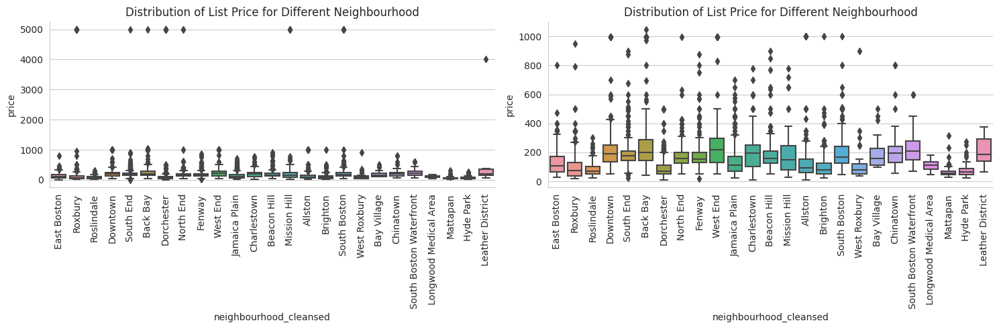

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming listing is already defined and you want to create boxplots of its data
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

sns.boxplot(x="neighbourhood_cleansed", y="price", data=listing, ax=axes[0])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90)
axes[0].set_title("Distribution of List Price for Different Neighbourhood")
sns.despine(ax=axes[0])

listing_wo_outlier = listing[(listing['price'] > 0) & (listing['price'] < 2000)]

sns.boxplot(x="neighbourhood_cleansed", y="price", data=listing_wo_outlier, ax=axes[1])
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90)
axes[1].set_title("Distribution of List Price for Different Neighbourhood")
sns.despine(ax=axes[1])

plt.tight_layout()
plt.show()

In the **above** *left* boxplot, we observe that there are outliers in the price upper limit of 5000 for certain neighborhoods. 

In order to have a better understanding of how AirBnbs are impacted by crime (which we determine by looking at different neighborhoods) we have eliminated the data points that are greater than a price of 2000, as shown in the *right* plot, so that our data will not be skewed. (Thus giving us a more accurate analysis of price per neighborhood). 

The *right* box plot **above** demonstrates that there is variation in list prices across different neighborhoods (and locations), later on we will be able to compare crime (per location or neighborhood) by listing price (per location or neighborhood). 

Next we want to think about a confounding factor that could be causing the data to be varied. One confounding variable we thought of (and wanted to look into) was if larger AirBnbs (or appartments), with more rooms, had higher listing prices. If this was a confounding variable, and we did not account for it, we may have data that was skewed because consumers may be more willing to stay in larger AirBnb's, or AirBnb's where they can share with more people (and therefore feel safer in areas of crime due to being surrounded by more people they trust). 

Therefore, our next step was to examine the price per bed for listings. 

In [ ]:
listing = listing_wo_outlier

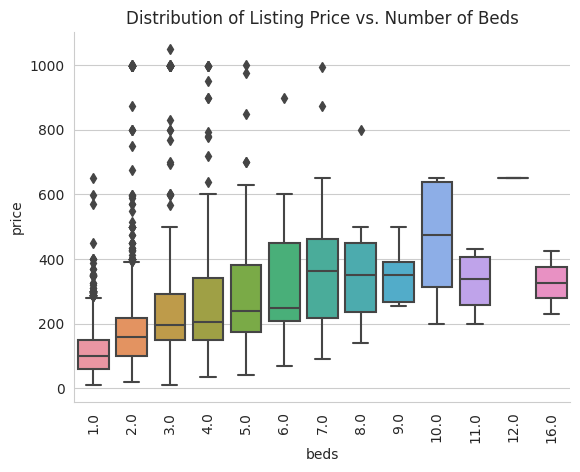

In [ ]:
sns.boxplot(x="beds", y="price", data=listing)
plt.xticks(rotation=90)
plt.title("Distribution of Listing Price vs. Number of Beds")
sns.despine()

The box plot presented **above** indicates that listing price becomes higher when the listings have more rooms, therefore suggesting that it may be a confounding variable 

Next, we want to look deeper into the data in relation to number of beds offered in a listing and the listing price, to help us confirm if this is a confounding variable and to determine how to reduce its possible effect on our results.

In [ ]:
# Relation between number of beds and listing price
listing.groupby('beds')['price'].agg(['count', 'mean', 'min', 'max']).round(2)

,count,mean,min,max
beds,,,,
1.0,2602,113.41,10,650
2.0,1266,185.23,19,1000
3.0,601,245.35,10,1050
4.0,248,267.56,35,999
5.0,87,298.26,40,1000
6.0,44,320.27,68,900
7.0,16,402.50,90,995
8.0,11,369.27,139,800
9.0,5,352.80,255,500


From the table **above**, we see that a listing with one bed has a mean price of 113.41 USD, compared to a listing with 5 beds which has a mean of 298.26 USD. Further, between 1 bed and 2 bed listings, there was an increase of 60% between their mean listing prices. We therefore have concluded that number of beds does have an impact of AirBnb pricing. This is helpful to our research as we now understand this may act as a confounding variable when examining how price is impacted by crime (if our data shows lower prices in higher crime areas, it may have been due to fewer beds being offered per listing). 

We will now account for this going further, as to avoid our data being heavily skewed (and therefore keeping us from accurately understanding the data). 

To do this, we will now create a new column for price per bed **below**:

In [ ]:
# Add new column: price per bed
listing['price_per_bed'] = listing['price']/listing['beds']
listing['price_per_bed'].describe().round(2)

count    4893.00
mean       99.68
std        66.68
min         3.33
25%        53.00
50%        83.33
75%       128.00
max       650.00
Name: price_per_bed, dtype: float64

From the data **above** we can see that the median price per room, in Boston, is about 83.33 USD. 

This gives us a baseline in understanding the fluctuations within listing prices, so that we can make more informed conclusions of criminal activity impacts on listing prices.

Our next step is to look at a boxplot of price per bed compared to neighborhoods, to understand if there are outliers here as well, and to see if there is variation in the data. (seen **below**).

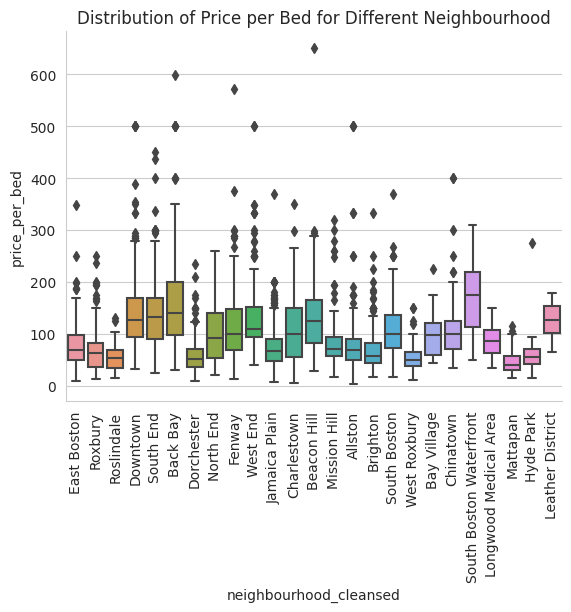

In [ ]:
sns.boxplot(x="neighbourhood_cleansed", y="price_per_bed", data=listing)
plt.xticks(rotation=90)
plt.title("Distribution of Price per Bed for Different Neighbourhood")
sns.despine()

From **above**, we still see that there is a difference in price-per-bed across different locations. Later, we will want to to see if there is an overlap of the differences in locations (seen above) and areas of active/frequent crime.

Next, however, we will take a look at review score data per neighborhood, as we felt this would also help us understand AirBnbs and their bookings in Boston.

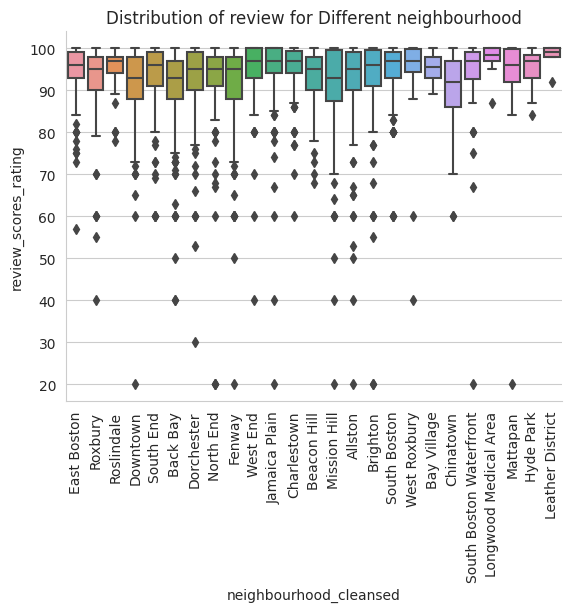

In [ ]:
sns.boxplot(x="neighbourhood_cleansed", y="review_scores_rating", data=listing)
plt.xticks(rotation=90)
plt.title("Distribution of review for Different neighbourhood")
sns.despine()

The box plot presented **above** indicates that review scores vary across different locations.

Next, we looked at the details of the data, to once again get a better understanding of it. 

In [ ]:
# data for reviews
listing['review_scores_rating'].describe().round(2)

count    4893.00
mean       93.35
std         8.23
min        20.00
25%        90.00
50%        95.00
75%        99.00
max       100.00
Name: review_scores_rating, dtype: float64

From the data **above** we can see that the average rating per AirBnb listing in Boston is 93.5, with a standard deviation of 8.23. 

We feel that there may be a selection bias, in that those consumers who provided ratings were those who were very satisfied with their stay. There may also be some extreme bias, which aligns with the selection bias, but further explains that on numbered scales (such as 1 to 100) consumers are more likely to rate in the extremes of the spectrum. 

We therefore may not have a completely accurate depiction of how consumers truly feel about AirBnb listings, or, as we delve deeper into our data throughout the notebook, that certain locations/neighborhoods/zip codes may have skewed results when it comes to their ratings/likeability. However, we will be using this data going forward for our assumptions, predications, and conclusions, but are keeping this in mind.

Our next steps were to assess the number of reviews(by zipcode) per listing, as we felt this would be consitent with the number of visits for a standard listing. 

In [ ]:
# Number of reviews by zipcode (neighborhoods), assumption that number of reviews is consistent with number of visits for a standard listing
listing.groupby('zipcode')['number_of_reviews_ltm'].sum()

zipcode
1125       7
2108    2231
2109    1425
2110     472
2111    2321
2113    5858
2114    6039
2115    3582
2116    8035
2118    5710
2119    4116
2120    1361
2121    1130
2122    2082
2124    2862
2125    4939
2126    1024
2127    5158
2128    8821
2129    1945
2130    5758
2131    1419
2132    1055
2134    3363
2135    4490
2136     871
2137      73
2138       1
2141       1
2143      36
2145       0
2149      15
2150       6
2163       3
2199       1
2210     566
2212       7
2215    3899
2446       0
2467       1
Name: number_of_reviews_ltm, dtype: int64

**Note for data above:**

As mentioned before, we took on the assumption that ratings per listing would be similar to bookings per listing (as we came to the realization that corresponding data was hard to find when it came to precise number of bookings per location). With that respect, we understand this data may not be perfectly accurately, and is most likely not accounting for all bookings per listing/location. However, we will be using this data in relation to the remainder of our data, findings, and conclusions.  




Next we eliminated zipcode data with less than 100 values because we wanted our data to have the same weight, or count, as other data we have collected that includes zipcode data

In [ ]:
listing.groupby('zipcode')['number_of_reviews_ltm'].sum().sort_values()
# Calculate the sum of 'number_of_reviews_ltm' for each 'zipcode'
zipcode_sums = listing.groupby('zipcode')['number_of_reviews_ltm'].sum()

# Filter out 'zipcode' with sums less than 100
valid_zipcodes = zipcode_sums[zipcode_sums >= 100].index

# Remove rows with 'zipcode' whose sum is less than 100
listing = listing[listing['zipcode'].isin(valid_zipcodes)]
listing.shape

(4873, 63)

In [ ]:
# Export csv for our dashboard
# listing.to_csv(path_or_buf='/content/gdrive/MyDrive/listing.csv', index=False)

## **Boston Crime Dataset**

After we finished exploring the AirBnb lisitng data, we wanted to look at the Boston crime dataset we had.

In [ ]:
# Remove data not in Boston
crime = crime[ ((crime.Lat > 42) & (crime.Lat < 43)) & ((crime.Long > -72) & (crime.Long < -70)) ]
# Show data
crime.head(3)

,Unnamed: 0,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,0,225520077,3126,NaN,WARRANT ARREST - OUTSIDE OF BOSTON WARRANT,D14,786,0,2022-02-02 00:00:00,2022,2,Wednesday,0,NaN,WASHINGTON ST,42.343081,-71.141723,"(42.34308127134165, -71.14172267328729)"
1,1,222648862,3831,NaN,M/V - LEAVING SCENE - PROPERTY DAMAGE,B2,288,0,2022-02-05 18:25:00,2022,2,Saturday,18,NaN,WASHINGTON ST,42.329748,-71.084540,"(42.329748204791635, -71.08454011649543)"
2,2,222201764,724,NaN,AUTO THEFT,C6,200,0,2022-01-09 00:00:00,2022,1,Sunday,0,NaN,W BROADWAY,42.341288,-71.054679,"(42.341287504390436, -71.05467932649397)"


The **above** is information showing the first three rows from our Boston Crime dataset, along with all of the columns in the dataset, so that we can get a better idea of what our data is, and how we can manipulate it.

This is the definition of each column.

1. INCIDENT_NUMBER: Internal BPD report number
2. OFFENSE_CODE: Numerical code of offense description
3. OFFENSE_CODE_GROUP: Numerical code of offense group description
4. DISTRICT: 
5. REPORTING_AREA: RA number associated with the where the crime was reported from.
6. SHOOTING: Indicated a shooting took place.
7. OCCURED_ON_DATE: Earliest date and time the incident could have taken place
8. YEAR: Year
9. MONTH: Month
10. DAY_OF_WEEK: Day of week 
11. HOUR: Hour
12. UCR_PART: Universal Crime Reporting Part number (1,2,3)
13. STREET: Street name the incident took place
14. Lat: Lattitude
15. Long: Longitude
16. Location: (Lattitude, Longitude)

### All crime categories and extract serious crimes.

Next we wanted to show categories of crimes and their frequency within Boston **below**, so that we can get a better understanding of what criminal activities happen the least and most in Boston. This will help us in comparing AirBnb ratings and criminal activity, and AirBnb price and criminal activity. This will help us understand how criminal activity may impact AirBnb availability/number of bookings.  

In [ ]:
# Remove data without OFFENSE_CODE_GROUP
crime = crime[crime['OFFENSE_CODE_GROUP'].notnull()]
# Show all rows
pd.set_option('display.max_rows', None)
print(crime['OFFENSE_CODE_GROUP'].value_counts())
# Reset the option to default
pd.reset_option('display.max_rows')

Motor Vehicle Accident Response              19384
Larceny                                      15428
Medical Assistance                           15285
Investigate Person                           11617
Other                                        10305
Simple Assault                                9544
Vandalism                                     8754
Verbal Disputes                               8753
Drug Violation                                8280
Investigate Property                          7418
Towed                                         7242
Property Lost                                 6365
Larceny From Motor Vehicle                    5918
Warrant Arrests                               4953
Aggravated Assault                            4576
Fraud                                         3755
Missing Person Located                        3222
Residential Burglary                          2816
Harassment                                    2749
Violations                     

What is the total number of crimes reported in Boston? 

> Total number of crime, per type of crime can be seen **above**

In [ ]:
crime.shape

(186216, 18)

After understanding what the data looks like, and how impactful specfic crimes are (frequency of a crime happening - because if it happens less often it may be seen as a one-of occurance, and severity of a crime), we wanted to take out those that would not be as impactful (or pertinent). This is beneficial to us because crimes that did not have as great of an effect on feelings of safety would therefore skew our data by showing high or stable likelihood of a consumer booking an AirBnb even in an area of 'crime'. Which is why we only want to look at serious crime that would make consumers feel unsafe, and therefore have an impact on their likelihood to book an AirBnb. 

In [ ]:
# Remove some irrelevant categories
crime = crime[~crime['OFFENSE_CODE_GROUP'].isin(['Motor Vehicle Accident Response', 
                                                 'Medical Assistance',
                                                 'Investigate Person',
                                                 'Other',
                                                 'Towed', 
                                                 'Property Lost', 
                                                 'Missing Person Located',
                                                 'Property Found',  'Property Found', 'Warrant Arrests', 'Fraud', 'Confidence Games', 'License Violation', 'Restraining Order Violations', 'Counterfeiting', 'Recovered Stolen Property', 'Commercial Burglary', 'Auto Theft Recovery', 'License Plate Related Incidents', 'Embezzlement', 'Harbor Related Incidents', 'Service', 'Evading Fare'
                                                 ])]
crime_counts=crime['OFFENSE_CODE_GROUP'].value_counts()

After removing less impactful crime, we wanted to reassess what the data looked like, which can be found **below**

In [ ]:
crime.shape

(93902, 18)

In [ ]:
crime_counts

Larceny                                      15428
Simple Assault                                9544
Vandalism                                     8754
Verbal Disputes                               8753
Drug Violation                                8280
Investigate Property                          7418
Larceny From Motor Vehicle                    5918
Aggravated Assault                            4576
Residential Burglary                          2816
Harassment                                    2749
Violations                                    2704
Auto Theft                                    2556
Robbery                                       2328
Missing Person Reported                       1995
Police Service Incidents                      1433
Disorderly Conduct                            1360
Fire Related Reports                          1123
Firearm Violations                             904
Liquor Violation                               648
Landlord/Tenant Disputes       

### **Brief Overview of Crime Rates in Boston**


Next, we wanted to look at a ranking of Boston's 10 highest rated crimes. This helps us further understand how crime impacts consumers in respect to AirBnb as we continue our analysis.

In [ ]:
crime_counts.head(10)

Larceny                       15428
Simple Assault                 9544
Vandalism                      8754
Verbal Disputes                8753
Drug Violation                 8280
Investigate Property           7418
Larceny From Motor Vehicle     5918
Aggravated Assault             4576
Residential Burglary           2816
Harassment                     2749
Name: OFFENSE_CODE_GROUP, dtype: int64

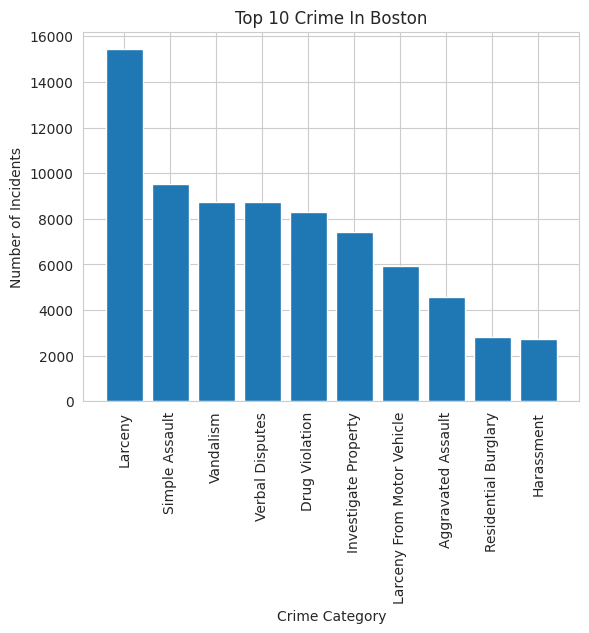

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


# Convert the dictionary to a pandas Series object
series_data = pd.Series(crime_counts.head(10))

# Plot the bar chart
plt.bar(series_data.index, series_data.values)

# Set the x-axis label
plt.xlabel('Crime Category')

# Set the y-axis label
plt.ylabel('Number of Incidents')

# Set the chart title
plt.title('Top 10 Crime In Boston')

# Rotate the x-axis labels for better readability
plt.xticks(rotation=90)

# Show the chart
plt.show()


**Above** we have created a bar chart for the 10 highest crimes in Boston.
This helps us better visualize the data, so that we can consume and understand it better, therefore allowing us to come to better conclusions when deciding how to organize and interpret our data throughout the remainder of the notebook.

What are the most common types of crimes reported in Boston?

> From the bar chart **above**, we can see that Boston's most common crime types are larcency, simple assault, and vandalism as the top three followed by verbal disputes, drug violation, and investigate property, with harassment being the least number of incidents recorded.  

# **Mapping the data**

## Understand the distrubution

Next we will map the listing data and crime data on the Boston Map to understand geolocational distribution.

In [ ]:
#https://data.boston.gov/dataset/zip-codes/resource/6f6cac0f-3fc0-48f8-98c4-48e37681b2ba
try:
  import geopandas as gpd
except:
  !pip install -q geopandas
  import geopandas as gpd
import matplotlib.pyplot as plt

# Load the GeoJSON file
gdf = gpd.read_file('https://bostonopendata-boston.opendata.arcgis.com/datasets/boston::zip-codes.geojson?outSR=%7B%22latestWkid%22%3A2249%2C%22wkid%22%3A102686%7D')
#gdf = gpd.read_file('/content/gdrive/MyDrive/Class/IS833/Team4/ZIP_Codes.geojson')

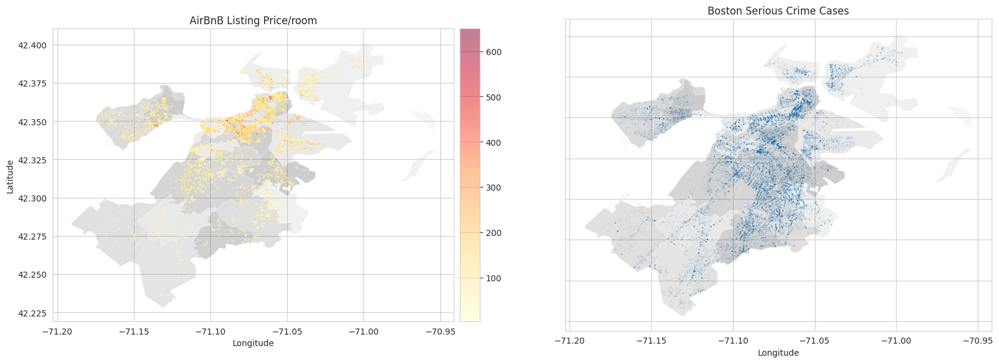

In [ ]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Create two separate subplots (1 row, 2 columns) with shared vertical axis
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

# Plot the background map on both subplots
gdf.plot(ax=ax1, cmap='gray', alpha=0.2)
gdf.plot(ax=ax2, cmap='gray', alpha=0.2)

# Plot the listing data on the first subplot using the scatter method
scatter_plot = ax1.scatter(x=listing["longitude"], y=listing["latitude"], marker='.', s=4, c=listing["price_per_bed"], cmap="YlOrRd", alpha=0.5)

# Set title and labels for the first subplot
ax1.set_title("AirBnB Listing Price/room")
ax1.set_xlabel("Longitude")
ax1.set_ylabel("Latitude")

# Create a custom axes for the colorbar with a smaller height
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)

# Add the colorbar to the custom axes
cb = plt.colorbar(scatter_plot, cax=cax)

# Plot the crime data on the second subplot using the scatter method
ax2.scatter(x=crime["Long"], y=crime["Lat"], marker='.', s=0.1, alpha=0.1)

# Set title and labels for the second subplot
ax2.set_title("Boston Serious Crime Cases")
ax2.set_xlabel("Longitude")

# No need to set the ylabel for ax2 since the vertical axis is shared

# Set the same axis limits for both subplots
ax1.set_xlim(ax2.get_xlim())
ax1.set_ylim(ax2.get_ylim())

# Set the aspect ratio for both plots to be equal
ax1.set_aspect('equal', adjustable='box')
ax2.set_aspect('equal', adjustable='box')

# Display the plots
plt.show()

For the **above** graph: 

The left graph displays the distribution of listing prices in the Boston area, where we can see a concentration of premium-priced listings in the heart of Boston and the Back Bay area. 

In contrast, the right graph highlights serious crime incidents across the same region, revealing elevated crime rates primarily in the downtown area and along major thoroughfares.

To understand the data better, we will make the map interactive with more detailed location information.

## Interactive map

In [ ]:
import folium
map_center = [listing["latitude"].mean(), listing["longitude"].mean()]

# Create the folium map
m = folium.Map(location=map_center, zoom_start=12)

# Add Airbnb listing points to the map
for idx, row in listing.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.1,
        popup=f'Price per bed: {row["price_per_bed"]}'
    ).add_to(m)
# Add crime points to the map
for idx, row in crime[:5000].iterrows():
    folium.CircleMarker(
        location=[row["Lat"], row["Long"]],
        radius=1,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.1,
        popup=f'OFFENSE_CODE_GROUP: {row["OFFENSE_CODE_GROUP"]}'
    ).add_to(m)
m

For the **above** interactive map: 

The blue dots display the distribution of listing prices in the Boston area.
The red dots highlight serious crime incidents.

This has allowed us to visualize how the variables (price and elevated crime) are displaced within Boston. We can now begin to interpret how the two variables are related. We can start to see that in areas of higher crime, there seem to be fewer listings. 

After this, we wanted to evaluate AirBnb availability over a year compared to crime in Boston. (seen **below**).

In [ ]:
#adding map that shows crime and availability of AirBnbs over a year 
# (yellow had more availability during the year and purple less therefore showing popularity of bookings per listing)
import folium
import branca.colormap as cm

map_center = [listing["latitude"].mean(), listing["longitude"].mean()]

# Create the folium map
m = folium.Map(location=map_center, zoom_start=12)

listing['zip'] = listing['zipcode'].apply(lambda x: '0' + str(x))
for idx, row in crime[crime.SHOOTING == 'Y'].iterrows():
    folium.CircleMarker(
        location=[row["Lat"], row["Long"]],
        radius=1,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.1,
        popup=f'OFFENSE_CODE_GROUP: {row["OFFENSE_CODE_GROUP"]}'
    ).add_to(m)

linear = cm.linear.viridis.scale(listing['availability_365'].min(), listing['availability_365'].max())

# Add AirBnb Availability to map
for idx, row in listing.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color=linear(row.availability_365),
        fill=True,
        fill_opacity=0.1,
        line_opacity= 0.8,
        popup=f'Availability: {row["availability_365"]}'
   ).add_to(m)
m

<ipython-input-231-7bf7fff66752>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listing['zip'] = listing['zipcode'].apply(lambda x: '0' + str(x))


For the interactive map **above**, we can see shootings in Boston by locating the red dots. We can also (roughly) tell how often a listing was availble throughout a year by looking at multi-colored dots (aside from red). Yellow represents listings that had higher days of availbility, purple respresents listings that had fewer days of availabilty. (Essentially lighter colors show higher amounts of availability, and darker colors show fewer amounts of availability). We can then infer that those listings with higher availbility had less bookings, and those with less availbility had more bookings. 

We can see that there are typically higher amounts of lighter colored listings (higher amounts of availbility of listings) closer to to the red dots (shootings). This may point to higher amounts of shootings (and therefore crime) having a negative impact on bookings (or positive impact on listing availbility frequency).

## Region(ZIPCODE)-based analysis

Next, we wanted to look at concentration of listing prices and listing reviews, to see where in Boston guests were willing to pay more, and where they were most satisfied staying. 

In [ ]:
import folium
from folium.plugins import DualMap

map_center = [listing["latitude"].mean(), listing["longitude"].mean()]

# Create the folium dual map with cartodb positron tiles
m = DualMap(location=map_center, zoom_start=12, tiles=None)

# Adding the cartodb positron tile layer to both maps
folium.TileLayer("cartodb positron").add_to(m.m1)
folium.TileLayer("cartodb positron").add_to(m.m2)

listing['zip'] = listing['zipcode'].apply(lambda x: '0' + str(x))

aggregated_df = listing.groupby('zip', as_index=False).agg({'price_per_bed': 'mean', 'review_scores_rating': 'mean'})

folium.Choropleth(
    geo_data=geojson,
    name="choropleth",
    data=aggregated_df,
    columns=["zip", "price_per_bed"],
    key_on="feature.properties.ZIP5",
    fill_color="YlOrBr",
    fill_opacity=0.7,
    line_opacity=.1,
    legend_name="price per bed",
).add_to(m.m1)

folium.Choropleth(
    geo_data=geojson,
    name="choropleth",
    data=aggregated_df,
    columns=["zip", "review_scores_rating"],
    key_on="feature.properties.ZIP5",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=.1,
    legend_name="review scores rating",
).add_to(m.m2)

folium.LayerControl().add_to(m)

m


<ipython-input-232-24ab4345428e>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listing['zip'] = listing['zipcode'].apply(lambda x: '0' + str(x))


For the **above** map: 

* To the left we can assess pricing per bed (darker colors for those with higher pricing)
* To the right we can assess reviews per listing (darker colors for those with higher ratings).

We can see a concentration of premium-priced listings in the heart of Boston and the Back Bay area. On the other hand, reviews are low in the premium-price listing areas as well as gunshooting crime areas.

We then wanted to look at a zipcode dataset we used to help link our datasets together.

In [ ]:
#@title
zcta.columns = zcta.columns.str.lower()

crime['OCCURRED_ON_DATE'] = pd.to_datetime(crime['OCCURRED_ON_DATE'])

zcta['zcta5ce20'] = pd.to_numeric(zcta['zcta5ce20'])
zcta.columns = zcta.columns.str.lower()
zcta['zcta5ce20'] = pd.to_numeric(zcta['zcta5ce20'])
zcta = zcta[['zcta5ce20', 'geometry']]

bcgdf = gpd.GeoDataFrame(crime, geometry=gpd.points_from_xy(crime['Long'], crime['Lat']))
bcgdf.drop(['Location', 'Lat', 'Long'], axis=1, inplace=True)
bcgdf.set_crs('EPSG:4269', inplace=True);
bcgdf = gpd.sjoin(bcgdf, zcta, how="left", predicate='within')
bcgdf.drop('index_right', axis=1, inplace=True)

zcta_crime_count = bcgdf.groupby('zcta5ce20')['INCIDENT_NUMBER'].count().reset_index()
zcta_crime_count.columns = ['zcta5ce20', 'crime']


mapop = ma_pop.iloc[1:, 1:3]
mapop.columns = ['zcta5ce20', 'pop']
mapop['zcta5ce20'] = pd.to_numeric(mapop['zcta5ce20'].str[-5:])
mapop['pop'] = pd.to_numeric(mapop['pop'])

zcta_crime_pop = zcta_crime_count.merge(mapop, on='zcta5ce20', how='left')

zcta_crime_pop = zcta_crime_pop.loc[zcta_crime_pop['pop'] > 0]

listing['zcta5ce20'] = listing['zipcode']
#zcta_abnb = listing.groupby('zcta5ce20')[['price', 'review_scores_rating']].mean().reset_index()
zcta_abnb = listing.groupby('zcta5ce20').mean().reset_index()

#zcta_abnb.columns = ['zcta5ce20', 'price', 'rating']

zcta_features = zcta_abnb.merge(zcta_crime_pop, on='zcta5ce20')
zcta_features['crime_rate'] = zcta_features['crime'] / zcta_features['pop']
#zcta_features.dropna(subset=['rating'], inplace=True)
zcta_features.dropna(subset=['review_scores_rating'], inplace=True)

zcta_features.head()

<ipython-input-233-d8b4a5ebf594>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listing['zcta5ce20'] = listing['zipcode']
<ipython-input-233-d8b4a5ebf594>:32: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  zcta_abnb = listing.groupby('zcta5ce20').mean().reset_index()


,zcta5ce20,host_response_rate,host_is_superhost,host_has_profile_pic,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_response_time_a few days or more,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,room_type_Entire home/apt,room_type_Private room,bed_type_Airbed,bed_type_Futon,bed_type_Pull-out Sofa,bed_type_Real Bed,cancellation_policy_flexible,cancellation_policy_moderate,cancellation_policy_strict,cancellation_policy_strict_14_with_grace_period,cancellation_policy_super_strict_30,price_per_bed,crime,pop,crime_rate
0,2108,0.378370,0.119565,1.0,0.293478,42.357406,-71.063415,0.945652,3.543478,1.228261,1.445652,1.760870,236.184783,392.923913,116.652174,2.423913,13.304348,6.630435,828.967391,7.548913,680.806522,13.521739,28.956522,44.771739,137.336957,61.902174,24.250000,93.445652,9.728261,9.521739,9.815217,9.750000,9.934783,9.228261,0.543478,0.010870,0.021739,67.717391,67.467391,0.250000,0.00000,2.208587,0.0,0.032609,0.021739,0.336957,0.923913,0.076087,0.0,0.01087,0.00000,0.98913,0.086957,0.195652,0.000000,0.673913,0.043478,155.909420,1391,4225,0.329231
1,2109,0.277465,0.267606,1.0,0.408451,42.362340,-71.053688,0.816901,4.028169,1.267606,1.464789,2.056338,210.098592,300.000000,73.169014,2.211268,18.732394,4.239437,752.253521,4.333803,623.752113,13.732394,29.985915,47.183099,151.169014,44.732394,20.070423,92.901408,9.591549,9.549296,9.690141,9.661972,9.873239,9.267606,0.507042,0.000000,0.014085,51.492958,51.211268,0.281690,0.00000,2.207465,0.0,0.014085,0.056338,0.211268,0.830986,0.169014,0.0,0.00000,0.00000,1.00000,0.154930,0.126761,0.000000,0.690141,0.028169,122.149061,1230,3627,0.339123
2,2110,0.113488,0.023256,1.0,0.000000,42.356505,-71.057011,0.627907,3.511628,1.267442,0.813953,1.720930,179.395349,322.093023,111.139535,2.255814,17.558140,2.651163,978.906977,2.748837,502.139535,10.511628,28.209302,51.279070,171.860465,20.930233,10.976744,92.069767,9.348837,9.581395,9.674419,9.697674,9.558140,9.116279,0.976744,0.069767,0.069767,168.627907,168.534884,0.093023,0.00000,1.270233,0.0,0.000000,0.000000,0.116279,1.000000,0.000000,0.0,0.00000,0.00000,1.00000,0.023256,0.023256,0.069767,0.744186,0.139535,118.482558,1093,2307,0.473775
3,2111,0.414444,0.163399,1.0,0.274510,42.351522,-71.061544,0.856209,3.692810,1.287582,1.326797,1.895425,209.647059,227.274510,84.163399,2.202614,12.542484,4.816993,851.111111,18.050980,657.522876,13.771242,30.712418,47.274510,120.032680,31.183007,15.169935,90.823529,9.450980,9.444444,9.718954,9.594771,9.549020,9.032680,0.647059,0.026144,0.117647,93.156863,91.614379,1.509804,0.03268,1.761765,0.0,0.000000,0.065359,0.352941,0.882353,0.104575,0.0,0.00000,0.00000,1.00000,0.091503,0.183007,0.013072,0.673203,0.039216,121.994242,2235,7841,0.285040
4,2113,0.216647,0.248555,1.0,0.260116,42.365290,-71.055386,0.884393,4.381503,1.170520,1.635838,2.167630,180.583815,139.445087,76.843931,1.861272,12.023121,3.127168,578824.439306,4.683815,578815.658960,13.341040,29.364162,46.612717,160.959538,78.398844,33.861272,92.682081,9.578035,9.277457,9.658960,9.716763,9.867052,9.179191,0.335260,0.000000,0.005780,20.023121,19.653179,0.369942,0.00000,3.430000,0.0,0.028902,0.023121,0.173410,0.947977,0.052023,0.0,0.00000,0.00578,0.99422,0.144509,0.300578,0.000000,0.531792

Next, we wanted to export our dashboard

In [ ]:
# Export csv for our dashboard
# zcta_features.to_csv(path_or_buf='/content/gdrive/MyDrive/zcta_features.csv', index=False)

In [ ]:
import folium
from folium.plugins import DualMap

map_center = [listing["latitude"].mean(), listing["longitude"].mean()]

# Create the folium dual map with cartodb positron tiles
m = DualMap(location=map_center, zoom_start=12, tiles=None)

# Adding the cartodb positron tile layer to both maps
folium.TileLayer("cartodb positron").add_to(m.m1)
folium.TileLayer("cartodb positron").add_to(m.m2)

zcta_features['zip'] = zcta_features['zcta5ce20'].apply(lambda x: '0' + str(x))

# Add the crime choropleth to the first map
folium.Choropleth(
    geo_data=geojson,
    name="choropleth",
    data=zcta_features,
    columns=["zip", "crime"],
    key_on="feature.properties.ZIP5",
    fill_color="RdPu",
    fill_opacity=0.7,
    line_opacity=.1,
    legend_name="crime",
).add_to(m.m1)

# Add the crime_rate choropleth to the second map
folium.Choropleth(
    geo_data=geojson,
    name="choropleth",
    data=zcta_features,
    columns=["zip", "crime_rate"],
    key_on="feature.properties.ZIP5",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=.1,
    legend_name="crime_rate",
).add_to(m.m2)

folium.LayerControl().add_to(m)

m


For the **above**: 

* The *left* map depicts the number of crime, for each zip code region, in Boston. 

* The *right* map shows the crime rate per capita in each zip code region of Boston.

There are regions where both the number of crime and crime rate are high, but we also observe the region such as Water Front where the number of crime is low but crime rate is high, which is caused by fewer residency in the region.

Our next steps were to further look at comparisons of the data, which we did through scatter plots

# **Scatter Plots of Crime and Ratings/Price**

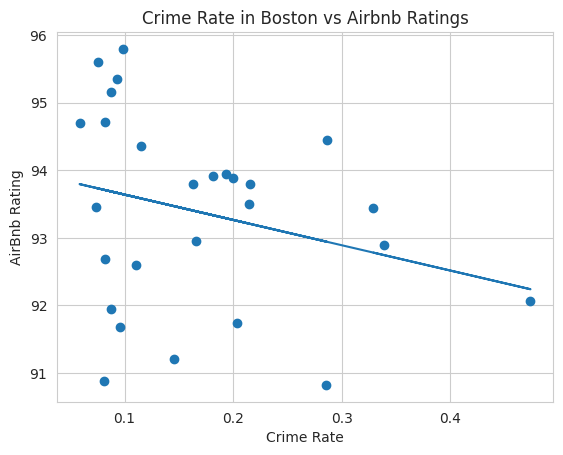

In [ ]:
#@title
# crime (x) and rating (y)
from sklearn.linear_model import LinearRegression
reg = LinearRegression()
reg.fit(zcta_features['crime_rate'].to_numpy().reshape(-1,1), zcta_features['review_scores_rating'].to_numpy().reshape(-1,1))
predictions= reg.predict(zcta_features['crime_rate'].to_numpy().reshape(-1,1))
plt.scatter(zcta_features['crime_rate'], zcta_features['review_scores_rating'])
plt.plot(zcta_features['crime_rate'], predictions)
plt.title("Crime Rate in Boston vs Airbnb Ratings")
plt.xlabel('Crime Rate')
plt.ylabel('AirBnb Rating')
plt.show()

## Crime in Boston vs AirBnb Ratings


The scatter plot **above** shows the comparison of Boston Crime Rates (x-axis) and Boston AirBnb Ratings (y-axis). We are able to see fairly clustered and related data, that follows a trend. From this we can see that as crime rates within Boston (for a zip code) increase, AirBnb Ratings (per corresponding zip code) decrease. Therefore we may be able to conclude that crime rates have an impact on ratings.

(However, we cannot rule out confounding variables for which we may not have accounted for, and want to keep this in mind overall - such as consumer's who may have had a particularly bad stay (and vice versa)).

 

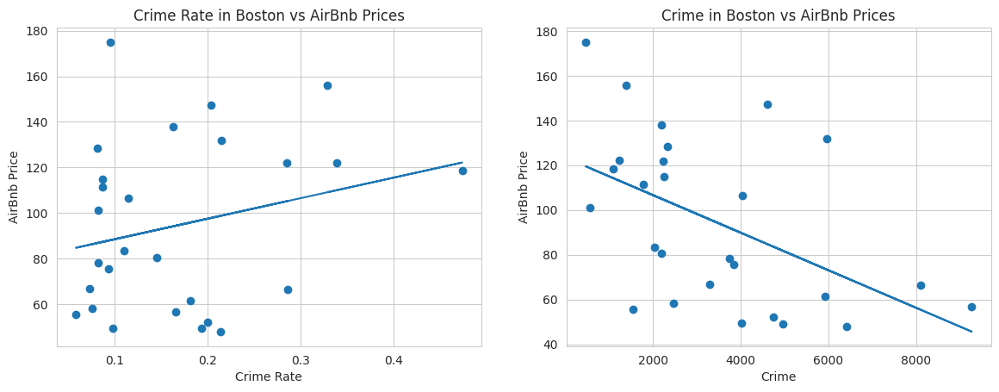

In [ ]:
from sklearn.linear_model import LinearRegression
reg_rate = LinearRegression()
reg_rate.fit(zcta_features['crime_rate'].to_numpy().reshape(-1,1), zcta_features['price_per_bed'].to_numpy().reshape(-1,1))
reg_nom = LinearRegression()
reg_nom.fit(zcta_features['crime'].to_numpy().reshape(-1,1), zcta_features['price_per_bed'].to_numpy().reshape(-1,1))
rate_pred = reg_rate.predict(zcta_features['crime_rate'].to_numpy().reshape(-1,1))
nom_pred = reg_nom.predict(zcta_features['crime'].to_numpy().reshape(-1,1))
fig, axs = plt.subplots(1, 2, figsize=(14.0, 4.8))
axs[0].scatter(zcta_features['crime_rate'], zcta_features['price_per_bed'])
axs[0].plot(zcta_features['crime_rate'], rate_pred)
axs[0].set_title("Crime Rate in Boston vs AirBnb Prices")
axs[0].set_xlabel('Crime Rate')
axs[0].set_ylabel('AirBnb Price')
axs[1].scatter(zcta_features['crime'], zcta_features['price_per_bed'])
axs[1].plot(zcta_features['crime'], nom_pred)
axs[1].set_title("Crime in Boston vs AirBnb Prices")
axs[1].set_xlabel('Crime')
axs[1].set_ylabel('AirBnb Price')
plt.show()

## Crime in Boston vs AirBnb Prices

The scatter plot **above** shows the comparison of Boston On the left: Crime Rates (x-axis) and Boston AirBnb Prices (y-axis). It is clear from the data we collected that we could not conlcude strong correlation, but a positive trend.
On the right: Crime (x-axis) and Boston AirBnb Prices (y-axis) we could see a stronger correlation, that was negative. 

How does the number of crimes reported in a neighborhood correlate with the average price per night for AirBnB listings in that neighborhood? 

Originally we looked at crime rate in Boston againist AirBnb prices, and we were not able to see a strong correlation (as the data was not very centered around the mean or trend line). However, after looking at crime v AirBnb prices we can see that there is a correlation. The correlation seems to be negative (as crime increases, prices decrease) and that the variance from the mean or trend line seems to be smaller (having a stronger correlation than we had prior). Before we were looking at crime rate, whicch took total number of crimes and divided it by the population, instead we decided to compare price to total number of crimes, to get an overall understanding of price and crime relationship  

Our next step was to look at AirBnb availability compared to crime in Boston, to gain a better understanding of trends and correlation

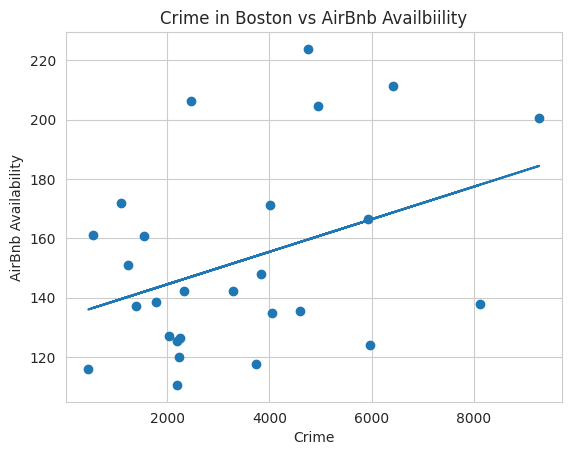

In [ ]:
#Scatter plot of crime and availbility of listings during the year - representing when AirBnbs were not booked
#We can see an upward trend line as crime increased, demonstrating that there were more availabiilies (less bookings) as crime increased in Boston

from sklearn.linear_model import LinearRegression
reg = LinearRegression()
reg.fit(zcta_features['crime'].to_numpy().reshape(-1,1), zcta_features['availability_365'].to_numpy().reshape(-1,1))
price_pred = reg.predict(zcta_features['crime'].to_numpy().reshape(-1,1))
plt.scatter(zcta_features['crime'], zcta_features['availability_365'])
plt.plot(zcta_features['crime'], price_pred)
plt.title("Crime in Boston vs AirBnb Availbiility")
plt.xlabel('Crime')
plt.ylabel('AirBnb Availability')
plt.show()

For the scatter plot **above**:

What is the correlation between the availability of AirBnB listings in a neighborhood and the number of crimes reported in that neighborhood?

>  We can see from the scatter plot **above** that there is a positive, but weak, correlation between Airbnb availbility and crime in Boston, as the data is not as cenetered around the trend line (mean) for us to confidently say there is a completely strong correlation. We can infer that as crime increases, AirBnb availbility increases, and thus bookings decrease. 

Now that we have begun to infer correlation as a result of our scatter plots, we wanted to look at the correlation heat map again with our joined datasets.

<ipython-input-241-429a56d7bb4c>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(zcta_features.corr(),annot=True,square=True)


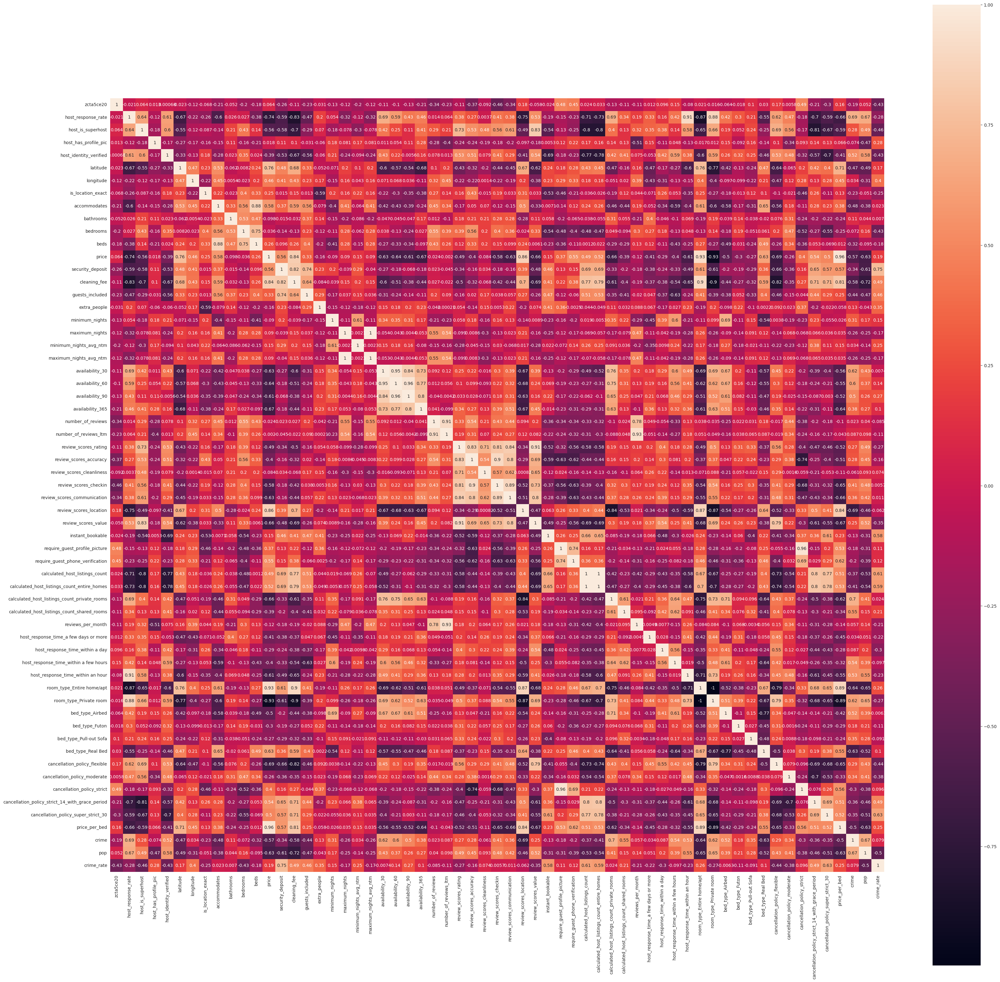

In [ ]:
import seaborn as sns
plt.subplots(figsize=(40,40))
sns.heatmap(zcta_features.corr(),annot=True,square=True)
plt.show()

In [ ]:
correlation_matrix = zcta_features.corr()
correlation_matrix["crime_rate"].sort_values(key=abs, ascending=False)

<ipython-input-242-18f822544717>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = zcta_features.corr()


crime_rate                                     1.000000
security_deposit                               0.752096
cancellation_policy_super_strict_30            0.630375
calculated_host_listings_count                 0.612227
calculated_host_listings_count_entire_homes    0.589779
                                                 ...   
review_scores_communication                    0.010552
availability_30                               -0.007414
bathrooms                                      0.007000
bed_type_Airbed                               -0.006295
review_scores_checkin                          0.005717
Name: crime_rate, Length: 61, dtype: float64

**Above** we can see that crime rate and review score rating were negatively correlated (-.27), and that crime and price per room were negatively correlated (-.5). Both of these can help us start to underdarstand and predict the impacts of crime on AirBnb bookings. We can also see crime and availability over a year are somewhat positively correlated (.38), this could can also help understand AirBnb bookings in higher areas of crime, by seeing if there are less bookings (more availbility) in areas of higher crime. 

**Below** is a list view of the correlations for AirBnb prices per bed. 

In [ ]:
correlation_matrix = zcta_features.corr()
pd.options.display.max_rows = None
print(correlation_matrix["price_per_bed"].sort_values(key=abs, ascending=False))
pd.reset_option('display.max_rows', 'display.max_columns')

price_per_bed                                      1.000000
price                                              0.960215
room_type_Entire home/apt                          0.888886
room_type_Private room                            -0.887772
review_scores_location                             0.835007
cleaning_fee                                       0.808830
latitude                                           0.705874
review_scores_value                               -0.671165
host_response_rate                                -0.661620
review_scores_communication                       -0.661528
review_scores_checkin                             -0.651505
cancellation_policy_flexible                      -0.646463
availability_365                                  -0.636888
pop                                               -0.627097
require_guest_phone_verification                   0.623934
calculated_host_listings_count_private_rooms      -0.622804
host_is_superhost                       

<ipython-input-243-105abee7c0d2>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = zcta_features.corr()


We then looked at a list view of correlations for AirBnb ratings.

In [ ]:
correlation_matrix = zcta_features.corr()
correlation_matrix["review_scores_rating"].sort_values(key=abs, ascending=False)

<ipython-input-244-a1879d22a92c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = zcta_features.corr()


review_scores_rating           1.000000
review_scores_value            0.906857
review_scores_communication    0.837215
review_scores_accuracy         0.834738
review_scores_checkin          0.806097
                                 ...   
maximum_nights                -0.098940
maximum_nights_avg_ntm        -0.098514
minimum_nights                 0.058412
extra_people                   0.053636
availability_90                0.033025
Name: review_scores_rating, Length: 61, dtype: float64

# Statistical Analytics



We now want to do further analysis to see if these assumptions are accurate/significant by looking at p-value.

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import pearsonr

def calculate_p_values(df, target_column):
    p_values = {}
    for column in df.columns:
        if column == target_column:
            continue
        if np.issubdtype(df[column].dtype, np.number):
            correlation, p_value = pearsonr(df[column], df[target_column])
            p_values[column] = p_value
    return p_values

p_values = calculate_p_values(zcta_features, "price_per_bed")

sorted_p_values = sorted(p_values.items(), key=lambda x: x[1])

# Determine the maximum length of the keys
max_key_length = max([len(key) for key, _ in sorted_p_values])

for key, value in sorted_p_values:
    # Use format() method to align key-value pairs
    print("{:<{}}\t{:.8f}".format(key, max_key_length, value))


price                                          	0.00000000
room_type_Entire home/apt                      	0.00000000
room_type_Private room                         	0.00000000
review_scores_location                         	0.00000006
cleaning_fee                                   	0.00000033
latitude                                       	0.00003899
review_scores_value                            	0.00012702
host_response_rate                             	0.00017118
review_scores_communication                    	0.00017167
review_scores_checkin                          	0.00023225
cancellation_policy_flexible                   	0.00026929
availability_365                               	0.00035412
pop                                            	0.00046424
require_guest_phone_verification               	0.00050571
calculated_host_listings_count_private_rooms   	0.00052128
host_is_superhost                              	0.00114889
security_deposit                               	0.001930

**Above** we are looking at the significance of our data

Number of crime is statistically siginificant:
crime     0.0072 < .05

Listing availability over a year was also statistically significant:
availability_365     	0.00035412 < .05



In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import pearsonr

def calculate_p_values(df, target_column):
    p_values = {}
    for column in df.columns:
        if column == target_column:
            continue
        if np.issubdtype(df[column].dtype, np.number):
            correlation, p_value = pearsonr(df[column], df[target_column])
            p_values[column] = p_value
    return p_values

p_values = calculate_p_values(zcta_features, "availability_365")

sorted_p_values = sorted(p_values.items(), key=lambda x: x[1])

# Determine the maximum length of the keys
max_key_length = max([len(key) for key, _ in sorted_p_values])

for key, value in sorted_p_values:
    # Use format() method to align key-value pairs
    print("{:<{}}\t{:.8f}".format(key, max_key_length, value))


availability_90                                	0.00000044
availability_60                                	0.00000223
availability_30                                	0.00001400
latitude                                       	0.00009717
price                                          	0.00013870
review_scores_location                         	0.00014589
price_per_bed                                  	0.00035412
room_type_Private room                         	0.00042975
calculated_host_listings_count_private_rooms   	0.00047759
room_type_Entire home/apt                      	0.00078962
bed_type_Airbed                                	0.00634292
review_scores_communication                    	0.00677799
host_response_rate                             	0.01549792
bed_type_Real Bed                              	0.01707870
review_scores_value                            	0.01882807
cleaning_fee                                   	0.02036452
host_is_superhost                              	0.035891

Above we are looking at the relationship between availability_365 and crime

Number of crime is statistically siginificant: crime 0.049 < .05


# Predict price

Now that we have determined if our data is correlated and significant, we want to work on predicting availability (and therefore amount of bookings - higher availbility = lower bookings) for an AirBnb as a result of crime. 

In [ ]:
crime_data = zcta_features[['zcta5ce20', 'crime', 'crime_rate', 'pop']]
listing_w_crime_data = pd.merge(listing, crime_data, left_on='zipcode', right_on='zcta5ce20', how='left')
listing_w_crime_data.describe()

,host_response_rate,host_is_superhost,host_has_profile_pic,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_response_time_a few days or more,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,room_type_Entire home/apt,room_type_Private room,bed_type_Airbed,bed_type_Futon,bed_type_Pull-out Sofa,bed_type_Real Bed,cancellation_policy_flexible,cancellation_policy_moderate,cancellation_policy_strict,cancellation_policy_strict_14_with_grace_period,cancellation_policy_super_strict_30,price_per_bed,zcta5ce20_y,crime,crime_rate,pop
count,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4.873000e+03,4873.000000,4.873000e+03,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000,4873.000000
mean,0.518845,0.281141,0.998769,0.427047,42.338396,-71.083573,0.839319,3.408988,1.260107,1.349887,1.844859,163.972091,146.128053,60.189616,1.770162,13.301457,4.064026,2.129286e+04,4.727375,2.124263e+04,13.625077,29.609686,45.501334,144.185512,40.393597,18.578289,93.352555,9.595732,9.459060,9.735481,9.686025,9.539503,9.299405,0.492715,0.018674,0.047404,33.780833,31.508927,2.016827,0.255079,2.051104,0.007182,0.034270,0.086394,0.409604,0.636979,0.347425,0.004104,0.005746,0.003283,0.986456,0.193926,0.279089,0.008824,0.498050,0.018469,99.800594,2128.327109,3701.866817,0.152151,27361.304946
std,0.489886,0.449602,0.035072,0.494700,0.026276,0.032526,0.367274,2.140291,0.501243,0.889923,1.264709,134.080101,275.318940,50.725040,1.368975,21.272415,12.238916,1.432513e+06,20.427841,1.432513e+06,12.076130,23.678668,34.442279,125.067855,60.579717,23.441453,8.232663,0.822956,0.893105,0.739463,0.785440,0.785575,0.878750,0.499998,0.135386,0.212523,77.183391,77.715033,4.294444,2.291375,2.151555,0.084453,0.181942,0.280974,0.491811,0.480920,0.476201,0.063939,0.075592,0.057213,0.115600,0.395412,0.448597,0.093531,0.500048,0.134654,66.751809,23.854876,1977.349036,0.078449,12615.434786
min,0.000000,0.000000,0.000000,0.000000,42.235760,-71.173506,0.000000,1.000000,0.000000,0.000000,1.000000,10.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.333333,2108.000000,462.000000,0.058592,2307.000000
25%,0.000000,0.000000,1.000000,0.000000,42.323821,-71.103733,1.000000,2.000000,1.000000,1.000000,1.000000,79.000000,0.000000,20.000000,1.000000,0.000000,1.000000,9.000000e+01,1.000000,9.000000e+01,0.00

In [ ]:
subset = listing_w_crime_data[["room_type_Entire home/apt",
                  "room_type_Private room", 
                  "review_scores_location",
                  "cleaning_fee",
                  "latitude",
                  "review_scores_value",
                  "host_response_rate",
                  "review_scores_communication",
                  "review_scores_checkin",
                  "cancellation_policy_flexible",
                  "price",
                  "pop",
                  "require_guest_phone_verification",
                  "calculated_host_listings_count_private_rooms",
                  "host_is_superhost",
                  "security_deposit",
                  "cancellation_policy_strict",
                  "host_response_time_within an hour",
                  "bed_type_Real Bed",
                  "calculated_host_listings_count_entire_homes",
                  "require_guest_profile_picture",
                  "review_scores_rating",
                  "cancellation_policy_super_strict_30",
                  "cancellation_policy_strict_14_with_grace_period",
                  "calculated_host_listings_count",
                  "review_scores_accuracy",
                  "crime",
                  "longitude",
                  "host_response_time_a few days or more",
                  "bed_type_Airbed",
                  "host_identity_verified",
                  "accommodates",
                  "calculated_host_listings_count_shared_rooms",
                  "cancellation_policy_moderate",
                  "host_response_time_within a few hours",
                  "bed_type_Futon",
                  "host_response_time_within a day",
                  "guests_included",
                  "bedrooms",
                  "crime_rate",
                  "bathrooms",
                  "bed_type_Pull-out Sofa",
                  "instant_bookable",
                  "minimum_nights_avg_ntm",
                  "reviews_per_month",
                  "is_location_exact",
                  "review_scores_cleanliness",
                  "number_of_reviews",
                  "host_has_profile_pic",
                  "extra_people",
                  "number_of_reviews_ltm",
                  "maximum_nights",
                  "maximum_nights_avg_ntm",
                  "minimum_nights",
                  "beds"
                  ]]
X = subset
X.shape

y = listing['availability_365']
y.shape

from sklearn.model_selection import train_test_split
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size = 0.3, random_state=833)

from sklearn.linear_model import LinearRegression
#model = LinearRegression()

from sklearn.linear_model import Ridge
#model = Ridge(alpha=1.0)

from sklearn.linear_model import Lasso
#model = Lasso(alpha=1.0)

from sklearn.linear_model import ElasticNet
#model = ElasticNet(alpha=1.0, l1_ratio=0.5)

from sklearn.svm import SVR
#model = SVR(kernel='linear', C=1.0)

from sklearn.ensemble import RandomForestRegressor
#model = RandomForestRegressor(n_estimators=100, random_state=833)

from sklearn.ensemble import GradientBoostingRegressor
#model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=833)

from xgboost import XGBRegressor
model = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=833)

model.fit(Xtrain, ytrain)
#model.fit(pd.get_dummies(Xtrain,columns='zipcode'), ytrain)

#print("Model coefficients:    ", model.coef_)
#print("Model intercept:", model.intercept_)

y_model = model.predict(Xtest)

from sklearn.metrics import mean_absolute_error
mean_absolute_error(ytest, y_model)

69.3096570735224

We obtained a mean absolute error of 69.3, so we can expect there to be high variance in our forecasts, or for there to be errors in the prediction of about 69 days give or take.



We then followed the model regression steps for AirBnb pricing over a year as well, helping us determine how much an AirBnb may be booked as a result of crime.

First we created a subset of data ('subset') to act as our X.

In [ ]:
subset2 = listing_w_crime_data[["room_type_Entire home/apt",
                  "room_type_Private room", 
                  "review_scores_location",
                  "cleaning_fee",
                  "latitude",
                  "review_scores_value",
                  "host_response_rate",
                  "review_scores_communication",
                  "review_scores_checkin",
                  "cancellation_policy_flexible",
                  "availability_365",
                  "pop",
                  "require_guest_phone_verification",
                  "calculated_host_listings_count_private_rooms",
                  "host_is_superhost",
                  "security_deposit",
                  "availability_30",
                  "cancellation_policy_strict",
                  "host_response_time_within an hour",
                  "bed_type_Real Bed",
                  "availability_60",
                  "calculated_host_listings_count_entire_homes",
                  "require_guest_profile_picture",
                  "availability_90",
                  "review_scores_rating",
                  "cancellation_policy_super_strict_30",
                  "cancellation_policy_strict_14_with_grace_period",
                  "calculated_host_listings_count",
                  "review_scores_accuracy",
                  "crime",
                  "longitude",
                  "host_response_time_a few days or more",
                  "bed_type_Airbed",
                  "host_identity_verified",
                  "accommodates",
                  "calculated_host_listings_count_shared_rooms",
                  "cancellation_policy_moderate",
                  "host_response_time_within a few hours",
                  "bed_type_Futon",
                  "host_response_time_within a day",
                  "guests_included",
                  "bedrooms",
                  "crime_rate",
                  "bathrooms",
                  "bed_type_Pull-out Sofa",
                  "instant_bookable",
                  "minimum_nights_avg_ntm",
                  "reviews_per_month",
                  "is_location_exact",
                  "review_scores_cleanliness",
                  "number_of_reviews",
                  "host_has_profile_pic",
                  "extra_people",
                  "number_of_reviews_ltm",
                  "maximum_nights",
                  "maximum_nights_avg_ntm",
                  "minimum_nights",
                  "beds"
                  ]]
X = subset2
X.shape

(4873, 58)

Next we called for the head of X to see what it contained, and looked like.

In [ ]:
X.head()

,room_type_Entire home/apt,room_type_Private room,review_scores_location,cleaning_fee,latitude,review_scores_value,host_response_rate,review_scores_communication,review_scores_checkin,cancellation_policy_flexible,availability_365,pop,require_guest_phone_verification,calculated_host_listings_count_private_rooms,host_is_superhost,security_deposit,availability_30,cancellation_policy_strict,host_response_time_within an hour,bed_type_Real Bed,availability_60,calculated_host_listings_count_entire_homes,require_guest_profile_picture,availability_90,review_scores_rating,cancellation_policy_super_strict_30,cancellation_policy_strict_14_with_grace_period,calculated_host_listings_count,review_scores_accuracy,crime,longitude,host_response_time_a few days or more,bed_type_Airbed,host_identity_verified,accommodates,calculated_host_listings_count_shared_rooms,cancellation_policy_moderate,host_response_time_within a few hours,bed_type_Futon,host_response_time_within a day,guests_included,bedrooms,crime_rate,bathrooms,bed_type_Pull-out Sofa,instant_bookable,minimum_nights_avg_ntm,reviews_per_month,is_location_exact,review_scores_cleanliness,number_of_reviews,host_has_profile_pic,extra_people,number_of_reviews_ltm,maximum_nights,maximum_nights_avg_ntm,minimum_nights,beds
0,1,0,10.0,75.0,42.365241,10.0,0.0,10.0,10.0,0,144,45501,0,0,1,0.0,0,0,0,1,24,1,0,54,99.0,1,0,1,10.0,3746,-71.029361,0,0,0,2,0,0,0,0,0,2,1.0,0.082328,1.0,0,0,30.0,0.33,1,10.0,14,1,0,1,1125,1125.0,30,1.0
1,1,0,9.0,40.0,42.329809,10.0,0.0,10.0,10.0,0,358,28307,0,0,1,0.0,30,0,0,1,60,6,0,90,95.0,0,1,6,10.0,8108,-71.095595,0,0,1,2,0,0,0,0,0,1,1.0,0.286431,1.0,0,1,3.0,0.67,1,10.0,80,1,0,29,730,730.0,3,1.0
2,1,0,9.0,70.0,42.329941,9.0,0.0,10.0,10.0,0,251,28307,0,0,1,0.0,0,0,0,1,0,6,0,13,97.0,0,1,6,10.0,8108,-71.093505,0,0,1,4,0,0,0,0,0,2,1.0,0.286431,1.0,0,1,3.0,0.74,1,10.0,85,1,8,19,730,730.0,3,2.0
3,0,1,9.0,0.0,42.292438,10.0,1.0,10.0,10.0,0,60,32609,0,1,1,0.0,27,0,1,1,42,0,1,60,98.0,0,0,1,10.0,2474,-71.135765,0,0,1,2,0,1,0,0,0,1,1.0,0.075869,1.0,0,0,3.0,0.65,1,10.0,75,1,30,15,60,60.0,3,1.0
4,1,0,10.0,250.0,42.359187,9.0,0.0,10.0,10.0,0,237,4225,0,0,0,1000.0,6,0,0,1,6,10,0,6,92.0,0,1,10,9.0,1391,-71.062651,0,0,0,2,0,0,0,0,0,1,1.0,0.329231,1.0,0,0,30.0,0.41,1,9.0,22,1,0,8,365,365.0,30,1.0


Next we created y for our regression. 

In [ ]:
y = listing['price']
y.shape

(4873,)

Next we wanted import the data to train our model

In [ ]:
from sklearn.model_selection import train_test_split
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size = 0.3, random_state=833)

In [ ]:
print("Xtrain shape:", Xtrain.shape)
print("Xtest shape:", Xtest.shape)
print("ytrain shape:", ytrain.shape)
print("ytest shape:", ytest.shape)

Xtrain shape: (3411, 58)
Xtest shape: (1462, 58)
ytrain shape: (3411,)
ytest shape: (1462,)


We then created our model, fit our model, and trained our model to predict price.

In [ ]:
from sklearn.linear_model import LinearRegression
#model = LinearRegression()

from sklearn.linear_model import Ridge
#model = Ridge(alpha=1.0)

from sklearn.linear_model import Lasso
#model = Lasso(alpha=1.0)

from sklearn.linear_model import ElasticNet
#model = ElasticNet(alpha=1.0, l1_ratio=0.5)

from sklearn.svm import SVR
#model = SVR(kernel='linear', C=1.0)

from sklearn.ensemble import RandomForestRegressor
#model = RandomForestRegressor(n_estimators=100, random_state=833)

from sklearn.ensemble import GradientBoostingRegressor
#model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=833)

from xgboost import XGBRegressor
model = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=833)

model.fit(Xtrain, ytrain)
#model.fit(pd.get_dummies(Xtrain,columns='zipcode'), ytrain)

#print("Model coefficients:    ", model.coef_)
#print("Model intercept:", model.intercept_)

y_model = model.predict(Xtest)

Next, we found the mean absolute error of our model, and got 39.84, which we felt was a low enough variance to have a fairly accurate prediction returned, as it would return an error in prediction of about 39.84 USD (give or take). 

In [ ]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(ytest, y_model)

39.84285570267287

We then wanted to look at Actual Price and Predicted Price, and created a table that displays the information **below**

In [ ]:
#ytest["predicted"]=y_model
result = pd.concat([ytest.reset_index(drop=True), pd.Series(y_model, name='predicted')], axis=1)
result.head(10)

,price,predicted
0,40,68.811737
1,69,89.633759
2,54,139.114792
3,153,122.286385
4,65,75.596565
5,50,103.786873
6,201,210.665466
7,40,56.460972
8,89,146.469116
9,400,352.559357


We then called for the data that would give us decriptive statistics on price and predicted price. 

In [ ]:
abs(result['price'] - result['predicted']).describe()

count    1462.000000
mean       39.842856
std        57.311941
min         0.033142
25%         8.927494
50%        22.149666
75%        47.253086
max       625.701813
dtype: float64

Next, we created a scatter plot to visualize actual price and predicted price.

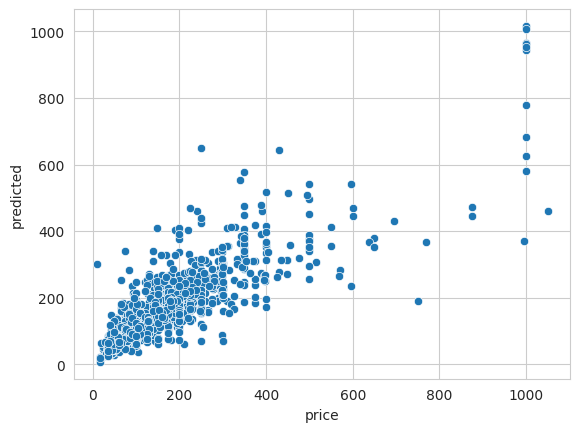

In [ ]:
sns.set_style("whitegrid")
sns.scatterplot(data=result, x="price", y="predicted")
plt.show()

The scatter plot shows that our model showing good prediction above $600 price.

## Recommendation of listings

Next, we use our model to find valued listings.

In [ ]:
full_result = pd.concat([result.reset_index(drop=True), Xtest.reset_index(drop=True)], axis=1)
full_result

,price,predicted,room_type_Entire home/apt,room_type_Private room,review_scores_location,cleaning_fee,latitude,review_scores_value,host_response_rate,review_scores_communication,review_scores_checkin,cancellation_policy_flexible,availability_365,pop,require_guest_phone_verification,calculated_host_listings_count_private_rooms,host_is_superhost,security_deposit,availability_30,cancellation_policy_strict,host_response_time_within an hour,bed_type_Real Bed,availability_60,calculated_host_listings_count_entire_homes,require_guest_profile_picture,availability_90,review_scores_rating,cancellation_policy_super_strict_30,cancellation_policy_strict_14_with_grace_period,calculated_host_listings_count,review_scores_accuracy,crime,longitude,host_response_time_a few days or more,bed_type_Airbed,host_identity_verified,accommodates,calculated_host_listings_count_shared_rooms,cancellation_policy_moderate,host_response_time_within a few hours,bed_type_Futon,host_response_time_within a day,guests_included,bedrooms,crime_rate,bathrooms,bed_type_Pull-out Sofa,instant_bookable,minimum_nights_avg_ntm,reviews_per_month,is_location_exact,review_scores_cleanliness,number_of_reviews,host_has_profile_pic,extra_people,number_of_reviews_ltm,maximum_nights,maximum_nights_avg_ntm,minimum_nights,beds
0,40,68.811737,0,1,10.0,40.0,42.289663,10.0,1.0,10.0,8.0,1,14,32609,0,1,0,0.0,14,0,1,1,14,0,0,14,80.0,0,0,1,10.0,2474,-71.121163,0,0,1,2,0,0,0,0,0,1,1.0,0.075869,2.5,0,0,2.0,1.00,1,4.0,1,1,20,1,30,30.0,2,1.0
1,69,89.633759,1,0,9.0,30.0,42.306270,10.0,0.0,10.0,10.0,1,210,41112,0,0,1,0.0,0,0,0,1,0,2,0,17,100.0,0,0,2,10.0,3837,-71.118586,0,0,1,2,0,0,0,0,0,1,1.0,0.093330,1.0,0,0,14.0,0.36,1,10.0,4,1,10,4,1125,1125.0,14,1.0
2,54,139.114792,0,1,10.0,0.0,42.346921,10.0,1.0,9.0,10.0,1,331,45024,0,1,0,0.0,10,0,1,1,27,0,0,56,93.0,0,0,1,10.0,3299,-71.148701,0,0,0,2,0,0,0,0,0,1,2.0,0.073272,2.0,0,1,1.0,5.00,1,10.0,46,1,50,46,30,30.0,1,2.0
3,153,122.286385,1,0,9.0,75.0,42.284373,9.0,1.0,9.0,10.0,1,0,32609,0,0,0,100.0,0,0,1,1,0,1,0,0,89.0,0,0,1,9.0,2474,-71.147026,0,0,0,6,0,0,0,0,0,6,3.0,0.075869,1.5,0,1,14.0,3.68,1,9.0,38,1,50,38,1125,1125.0,14,3.0
4,65,75.596565,0,1,10.0,30.0,42.314414,9.0,0.0,9.0,10.0,0,262,41112,0,4,1,0.0,0,0,0,1,0,0,0,1,94.0,0,1,4,10.0,3837,-71.102399,0,0,1,2,0,0,0,0,0,1,1.0,0.093330,1.0,0,1,1.0,3.49,1,9.0,51,1,5,46,1125,1125.0,1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1457,90,92.161621,0,1,10.0,45.0,42.359962,9.0,1.0,10.0,10.0,0,58,13401,0,2,1,0.0,10,0,1,1,32,0,0,58,95.0,0,1,2,10.0,2188,-71.064103,0,0,0,1,0,0,0,0,0,1,1.0,0.163271,1.0,0,0,2.0,6.02,1,9.0,104,1,35,90,1124,1124.0,2,1.0
1458,99,83.811836,0,1,10.0,35.0,42.331945,10.0,1.0,10.0,10.0,0,65,15082,0,1,1,0.0,6,0,1,1,30,0,0,53,99.0,0,0,1,10.0,2195,-71.108644,0,0,0,2,0,1,0,0,0,2,1.0,0.145538,1.0,0,1,1.0,9.14,1,10.0,249,1,0,90,14,14.0,1,1.0
1459,60,67.771439,0,1,10.0,8.0,42.333117,10.0,1.0,10.0,10.0,0,80,28559,0,1,0,0.0,20,0,1,1,50,0,0,80,94.0,0,0,1,10.0,2323,-71.106443,0,0,0,1,0,1,0,0,0,1,1.0,0.081340,1.0,0,0,1.0,4.98,1,10.0,114,1,0,66,1125,1125.0,1,1.0
1460,353,310.138000,1,0,10.0,95.0,42.345560,10.0,1.0,10.0,10.0,0,0,28559,0,0,0,0.0,0,0,1,1,0,11,0,0,100.0,0,1,11,10.0,2323,-71.086139,0,0,0,7,0,0,0,0,0,1,3.0,0.081340,1.0,0,1,2.0,1.46,1,10.0,14,1,0,14,1125,1125.0,2,3.0


We assume if the predicted price is higher than actial price, the listing has more value than actual price.

In [ ]:
valued_price_listing = full_result[full_result["predicted"] > full_result["price"] * 1.5] # Predicted price is 150% higher than acttual price
valued_price_listing

,price,predicted,room_type_Entire home/apt,room_type_Private room,review_scores_location,cleaning_fee,latitude,review_scores_value,host_response_rate,review_scores_communication,review_scores_checkin,cancellation_policy_flexible,availability_365,pop,require_guest_phone_verification,calculated_host_listings_count_private_rooms,host_is_superhost,security_deposit,availability_30,cancellation_policy_strict,host_response_time_within an hour,bed_type_Real Bed,availability_60,calculated_host_listings_count_entire_homes,require_guest_profile_picture,availability_90,review_scores_rating,cancellation_policy_super_strict_30,cancellation_policy_strict_14_with_grace_period,calculated_host_listings_count,review_scores_accuracy,crime,longitude,host_response_time_a few days or more,bed_type_Airbed,host_identity_verified,accommodates,calculated_host_listings_count_shared_rooms,cancellation_policy_moderate,host_response_time_within a few hours,bed_type_Futon,host_response_time_within a day,guests_included,bedrooms,crime_rate,bathrooms,bed_type_Pull-out Sofa,instant_bookable,minimum_nights_avg_ntm,reviews_per_month,is_location_exact,review_scores_cleanliness,number_of_reviews,host_has_profile_pic,extra_people,number_of_reviews_ltm,maximum_nights,maximum_nights_avg_ntm,minimum_nights,beds
0,40,68.811737,0,1,10.0,40.0,42.289663,10.0,1.0,10.0,8.0,1,14,32609,0,1,0,0.0,14,0,1,1,14,0,0,14,80.0,0,0,1,10.0,2474,-71.121163,0,0,1,2,0,0,0,0,0,1,1.0,0.075869,2.5,0,0,2.0,1.00,1,4.0,1,1,20,1,30,30.0,2,1.0
2,54,139.114792,0,1,10.0,0.0,42.346921,10.0,1.0,9.0,10.0,1,331,45024,0,1,0,0.0,10,0,1,1,27,0,0,56,93.0,0,0,1,10.0,3299,-71.148701,0,0,0,2,0,0,0,0,0,1,2.0,0.073272,2.0,0,1,1.0,5.00,1,10.0,46,1,50,46,30,30.0,1,2.0
5,50,103.786873,0,1,10.0,0.0,42.352684,10.0,0.0,10.0,10.0,1,0,25856,0,1,0,0.0,0,0,0,1,0,1,0,0,100.0,0,0,2,10.0,2253,-71.121248,0,0,1,2,0,0,0,0,0,1,1.0,0.087136,1.0,0,0,3.0,0.03,1,10.0,1,1,0,0,1125,1125.0,3,1.0
8,89,146.469116,1,0,10.0,25.0,42.326951,10.0,1.0,10.0,10.0,0,65,28307,0,0,0,0.0,5,0,1,1,35,1,0,65,100.0,0,1,1,10.0,8108,-71.081932,0,0,0,2,0,0,0,0,0,1,1.0,0.286431,1.0,0,1,2.0,1.94,1,10.0,4,1,40,4,1125,1125.0,2,1.0
13,240,460.008423,1,0,10.0,80.0,42.359084,9.0,1.0,10.0,10.0,0,228,13401,0,1,1,0.0,0,0,1,1,0,1,0,0,96.0,0,0,2,10.0,2188,-71.067742,0,0,1,5,0,1,0,0,0,1,2.0,0.163271,1.0,0,0,1.0,0.73,1,10.0,30,1,50,16,1125,1125.0,1,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1425,199,390.435425,1,0,10.0,150.0,42.340959,10.0,1.0,10.0,10.0,0,0,35266,0,0,0,0.0,0,0,1,1,0,1,0,0,96.0,0,1,1,10.0,4045,-71.051296,0,0,0,14,0,0,0,0,0,6,4.0,0.114700,2.5,0,1,1.0,7.75,1,9.0,46,1,25,46,1125,1125.0,1,10.0
1432,169,263.185089,1,0,10.0,99.0,42.366428,9.0,0.0,9.0,8.0,0,81,13401,0,0,0,0.0,29,0,0,1,56,5,0,81,80.0,0,0,5,8.0,2188,-71.062904,0,0,0,4,0,1,0,0,0,1,2.0,0.163271,2.0,0,0,1.0,0.59,0,7.0,6,1,0,6,1125,1125.0,1,3.0
1445,40,68.902809,0,1,9.0,15.0,42.320755,9.0,1.0,10.0,10.0,0,76,41112,0,2,0,0.0,13,0,1,1,27,0,0,53,94.0,0,1,2,9.0,3837,-71.105669,0,0,0,2,0,0,0,0,0,1,1.0,0.093330,1.0,0,1,3.0,2.96,1,9.0,50,1,20,36,29,29.0,3,1.0
1452,35,62.428635,0,1,10.0,35.0,42.275737,10.0,1.0,10.0,10.0,0,62,25572,0,1,1,0.0,20,0,0,1,36,1,0,53,98.0,0,0,2,10.0,4954,-71.089285,0,0,1,2,0,1,1,0,0,1,1.0,0.193728,1.5,0,0,2.0,1.60,0,10.0,23,1,10,20,1125,1125.0,2,2.0


Next, we want to recommend listings in relatively safer areas. 

In [ ]:
recommended_listing = valued_price_listing[(full_result["crime_rate"] < 0.1) & (full_result["crime"] < 2000)] # Safer area
recommended_listing

<ipython-input-261-be5fc1bb42bf>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  recommended_listing = valued_price_listing[(full_result["crime_rate"] < 0.1) & (full_result["crime"] < 2000)] # Safer area


,price,predicted,room_type_Entire home/apt,room_type_Private room,review_scores_location,cleaning_fee,latitude,review_scores_value,host_response_rate,review_scores_communication,review_scores_checkin,cancellation_policy_flexible,availability_365,pop,require_guest_phone_verification,calculated_host_listings_count_private_rooms,host_is_superhost,security_deposit,availability_30,cancellation_policy_strict,host_response_time_within an hour,bed_type_Real Bed,availability_60,calculated_host_listings_count_entire_homes,require_guest_profile_picture,availability_90,review_scores_rating,cancellation_policy_super_strict_30,cancellation_policy_strict_14_with_grace_period,calculated_host_listings_count,review_scores_accuracy,crime,longitude,host_response_time_a few days or more,bed_type_Airbed,host_identity_verified,accommodates,calculated_host_listings_count_shared_rooms,cancellation_policy_moderate,host_response_time_within a few hours,bed_type_Futon,host_response_time_within a day,guests_included,bedrooms,crime_rate,bathrooms,bed_type_Pull-out Sofa,instant_bookable,minimum_nights_avg_ntm,reviews_per_month,is_location_exact,review_scores_cleanliness,number_of_reviews,host_has_profile_pic,extra_people,number_of_reviews_ltm,maximum_nights,maximum_nights_avg_ntm,minimum_nights,beds
80,99,168.569016,1,0,10.0,45.0,42.364951,10.0,0.0,10.0,10.0,0,0,6726,0,0,1,100.0,0,0,0,1,0,1,0,0,99.0,0,0,1,10.0,553,-71.057207,0,0,1,3,0,1,0,0,0,2,1.0,0.082218,1.0,0,0,2.0,1.64,1,10.0,30,1,25,16,1125,1125.0,2,1.0
149,200,386.950684,1,0,10.0,150.0,42.377462,9.0,1.0,9.0,9.0,0,328,20411,0,0,0,250.0,25,0,1,1,55,23,0,85,98.0,0,1,23,9.0,1783,-71.060987,0,0,1,8,0,0,0,0,0,3,3.0,0.087355,2.5,0,0,30.0,1.53,1,9.0,8,1,10,8,1125,1125.0,30,5.0
185,42,146.814926,0,1,10.0,0.0,42.269620,10.0,1.0,10.0,10.0,1,0,26437,0,1,0,0.0,0,0,1,1,0,0,0,0,100.0,0,0,1,10.0,1549,-71.148297,0,0,0,2,0,0,0,0,0,1,1.0,0.058592,1.0,0,1,1.3,0.48,1,10.0,1,1,0,1,2,2.0,1,1.0
310,80,165.546356,1,0,10.0,92.0,42.366465,10.0,0.0,10.0,10.0,0,10,6726,0,0,0,0.0,5,0,0,1,10,1,0,10,96.0,0,0,1,10.0,553,-71.053757,0,0,1,2,0,1,0,0,0,2,1.0,0.082218,1.0,0,0,2.0,2.76,1,10.0,101,1,0,34,1125,1125.0,2,2.0
323,43,104.032715,0,1,10.0,0.0,42.377909,10.0,1.0,10.0,10.0,1,15,20411,0,1,0,0.0,15,0,0,1,15,0,0,15,100.0,0,0,1,8.0,1783,-71.063528,0,0,0,1,0,0,1,0,0,1,0.0,0.087355,1.0,0,1,7.0,0.55,0,8.0,2,1,0,2,30,30.0,7,1.0
393,80,125.603416,0,1,10.0,25.0,42.375196,9.0,0.0,10.0,10.0,1,0,20411,0,1,0,0.0,0,0,0,1,0,0,0,0,95.0,0,0,1,10.0,1783,-71.063066,0,0,1,1,0,0,0,0,0,1,1.0,0.087355,1.0,0,1,1.0,1.20,1,10.0,27,1,0,1,7,7.0,1,1.0
534,87,136.250168,0,1,10.0,0.0,42.380110,10.0,1.0,10.0,10.0,1,33,20411,0,1,1,0.0,6,0,0,1,8,0,0,33,93.0,0,0,1,10.0,1783,-71.068142,0,0,1,2,0,0,1,0,0,1,1.0,0.087355,1.0,0,0,3.0,2.43,0,9.0,64,1,0,33,1125,1125.0,3,1.0
978,95,143.536469,0,1,10.0,60.0,42.365390,10.0,1.0,10.0,10.0,0,138,6726,1,1,1,300.0,6,0,1,1,36,0,0,57,98.0,0,0,1,10.0,553,-71.054382,0,0,1,5,0,1,0,0,0,2,1.0,0.082218,1.0,0,0,2.0,2.39,1,10.0,212,1,50,43,1825,1825.0,2,1.0
1072,169,260.888336,1,0,10.0,150.0,42.377387,10.0,0.0,10.0,10.0,1,4,20411,0,0,1,0.0,4,0,0,1,4,1,0,4,96.0,0,0,1,10.0,1783,-71.060435,0,0,1,6,0,0,0,0,0,4,2.0,0.087355,1.0,0,1,5.0,1.16,1,10.0,105,1,25,24,1124,1124.0,5,3.0
1147,100,167.145203,1,0,10.0,25.0,42.377550,10.0,1.0,10.0,10.0,0,256,20411,0,0,1,0.0,19,0,0,1,19,1,0,31,98.0,0,0,1,10.0,1783,-71.062805,0,0,1,4,0,1,1,0,0,1,1.0,0.087355,1.0,0,0,2.0,4.20,1,10.0,320,1,0,37,60,60.0,2,2.0


We got 11 valued listings! We show them on the map.

In [ ]:
import folium
map_center = [valued_price_listing["latitude"].mean(), valued_price_listing["longitude"].mean()]

# Create the folium map
m = folium.Map(location=map_center, zoom_start=12)

# Add Airbnb listing points to the map
for idx, row in recommended_listing.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.1,
        popup=f'Price: {row["price"]}, Predicted: {round(row["predicted"],1)}'
    ).add_to(m)
m

It seems Chalestown and North End tend to have value listings.


# Conclusion

Overall, we analyzed the potential correlation between the number of crimes committed in a particular area and Airbnb reservations made in the same area, based on review scores, AirBnb prices, AirBnb availability, and crime data in Boston. We see a statistical significance between the number of crimes committed in a particular area and the price of Airbnb listings in that area, specifically when it came to AirBnb price (p-value of 0.0072) and Airbnb availbility (p-value of 0.049). In addition, our predictive model shows that crime rates are a significant predictor of Airbnb listing prices, even after controlling for other factors such as location and property type (where we saw a mean absolute error of about 40 USD when it came to predicating AirBnb prices). This model can be used to help hosts choose optimal prices for their listings (especially when it comes to crime). As well as help hosts and policymakers make more informed decisions about pricing and safety measures with Boston. 

While our study has some limitations, such as lack of accurate location data between our datasets, and the lack of information on percise bookings per listing, and Airbnb success rates per location; our results provide valuable insights into the complex relationship between crime in Boston and Airbnb pricing, reviews, and availability in Boston. For future research, we suggest controlling for other factors that may affect Airbnb ratings, such as property size, amenities, and host and guest characteristics. In addition, we can compare our results with those of other cities to have a more comprehensive understanding of the relationship between crime rates and Airbnb ratings, price, and availability overall.

In conclusion, our study provides valuable insights into the relationship between crime rates and Airbnb listing prices. However, we should also acknowledge that guests may have different attitudes towards safety, and some listings in higher crime areas still receive high ratings. Therefore, further research is needed to fully understand the complex relationship between crime rates and Airbnb reservations.

## Challenges

We faced many issues when compeleting this project, that included the following:

* Using multiple datasets
* Correctly using our data
* Missinig useful data
* Interpreting our data
 

1. When we chose to use two datasets when we first decided on our project proposal we knew it would not be easy, but we did not think it would be as cumbersome as it turned out to be. While it led to greater insights, analysis, and deeper learning, it took more time and effort. This is because we had to clean the datasets, figure out how to join them, determine what data was useful, and interpret both datasets (incorporating both datasets when codinig). This therefore made our code more complex, a lot of which we had to further build upon our skills from class. Had we kept it to one dataset, and manipulated the data within a single dataset, it may have made the cleaning, analysis, and interpretation proccess easier. 

2. We also saw challenges when it came to correctly using our data. There were timies when we started comparing data that we thought would be helpful or beneficial to the project, but then came to the conclusioin that other points of data would be helpful. For example, we initially used number of reviews to estimate number of AirBnb bookings (number of ratings corresponding to number of times an AirBnb was booked), and while this gave useful insights, it was not very accurate. Eventually, we realized we could use availability of a listing over a year to better understand how much a listing was booked (those with more availability had less bookings, and vice versa). We also initially compared crime rate to AirBnb ratinigs, and to AirBnb prices as well. While we thought this gave us accurate results, we learned that we should have been using crime instead as it actually gave accurate trends for impacts on ratings and prices. 

3. The previous point brings us to our next challenge, which was that we were missing data that could have been useful, this prohibited us from getting accurate results, and sometimes misunderstanding of the data. An example of this was mentioned in number 2, where we did not have information on number of bookings per listing, so we had to estimate with other data we had. It also led to issues in comparing the datasets. For example, our Boston crime dataset did not have zipcode data, so we initially downloaded another zipcode data set to get a more accurate understanding of locational impact on Airbnb listings.

4. All of these challenges further complicated our process by making it difficult to understand and intrepret our data. In order to accurately intrpret the data and findings we had to put in a lot of extra time and extra learning of python code. For example, when it came to the regression and mean absolute error, we had to take the time to understand how to approach coding it (since we were not usinig one data set).

Google Dashboard:

# References:
- Chat-GPT3.5/4.0 (https://chat.openai.com/) for graph visualization.
- US Census to locate zip codes to AirBnb listings in Boston (https://www.census.gov/cgi-bin/geo/shapefiles/index.php?year=2022&layergroup=ZIP+Code+Tabulation+Areas)
- Us Census to gather data on Boston population (https://data.census.gov/table?q=population&g=040XX00US25$8600000&tid=ACSDP5Y2021.DP05)